# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

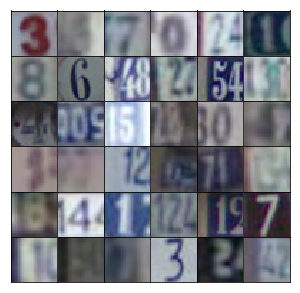

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)

for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.001
batch_size = 128
epochs = 24
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/24... Discriminator Loss: 0.0846... Generator Loss: 15.9351
Epoch 1/24... Discriminator Loss: 0.0244... Generator Loss: 5.9348
Epoch 1/24... Discriminator Loss: 0.0716... Generator Loss: 20.2253
Epoch 1/24... Discriminator Loss: 0.5459... Generator Loss: 1.3941
Epoch 1/24... Discriminator Loss: 0.9931... Generator Loss: 2.1962
Epoch 1/24... Discriminator Loss: 0.9086... Generator Loss: 1.1106
Epoch 1/24... Discriminator Loss: 0.5166... Generator Loss: 2.0583
Epoch 1/24... Discriminator Loss: 0.5055... Generator Loss: 1.5350
Epoch 1/24... Discriminator Loss: 1.8685... Generator Loss: 0.2815
Epoch 1/24... Discriminator Loss: 0.5096... Generator Loss: 1.4447


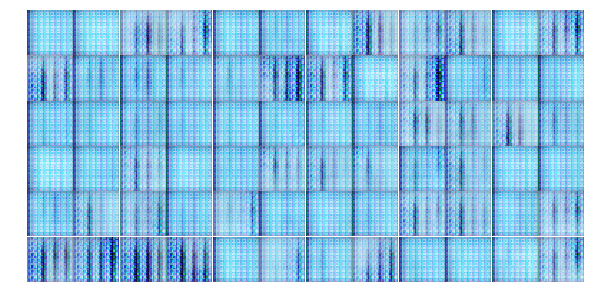

Epoch 1/24... Discriminator Loss: 1.6643... Generator Loss: 2.5170
Epoch 1/24... Discriminator Loss: 2.3757... Generator Loss: 0.1810
Epoch 1/24... Discriminator Loss: 1.1671... Generator Loss: 2.6706
Epoch 1/24... Discriminator Loss: 0.7104... Generator Loss: 1.8193
Epoch 1/24... Discriminator Loss: 1.5163... Generator Loss: 1.7592
Epoch 1/24... Discriminator Loss: 0.9187... Generator Loss: 2.2043
Epoch 1/24... Discriminator Loss: 1.1855... Generator Loss: 1.2267
Epoch 1/24... Discriminator Loss: 1.0542... Generator Loss: 0.9332
Epoch 1/24... Discriminator Loss: 0.5491... Generator Loss: 1.2357
Epoch 1/24... Discriminator Loss: 0.6422... Generator Loss: 1.2227


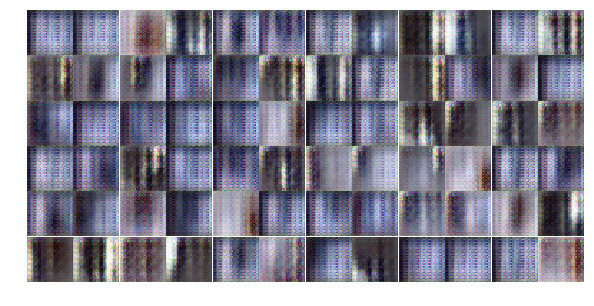

Epoch 1/24... Discriminator Loss: 1.0910... Generator Loss: 0.5559
Epoch 1/24... Discriminator Loss: 1.1426... Generator Loss: 1.0797
Epoch 1/24... Discriminator Loss: 1.4591... Generator Loss: 0.5726
Epoch 1/24... Discriminator Loss: 1.1685... Generator Loss: 0.9084
Epoch 1/24... Discriminator Loss: 1.3627... Generator Loss: 2.1294
Epoch 1/24... Discriminator Loss: 1.0981... Generator Loss: 0.9414
Epoch 1/24... Discriminator Loss: 0.5991... Generator Loss: 1.3273
Epoch 1/24... Discriminator Loss: 0.5720... Generator Loss: 1.6893
Epoch 1/24... Discriminator Loss: 0.5459... Generator Loss: 1.3183
Epoch 1/24... Discriminator Loss: 1.1177... Generator Loss: 1.1554


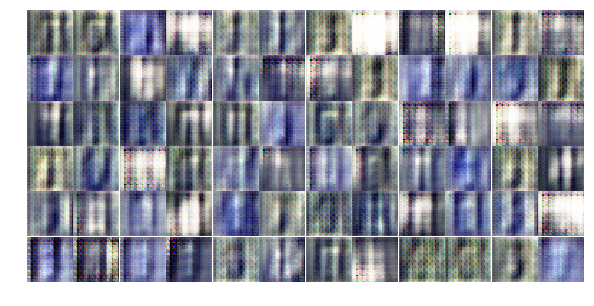

Epoch 1/24... Discriminator Loss: 1.2194... Generator Loss: 0.6962
Epoch 1/24... Discriminator Loss: 1.1234... Generator Loss: 0.8469
Epoch 1/24... Discriminator Loss: 1.1404... Generator Loss: 1.0330
Epoch 1/24... Discriminator Loss: 1.2381... Generator Loss: 0.8221
Epoch 1/24... Discriminator Loss: 1.2849... Generator Loss: 0.8413
Epoch 1/24... Discriminator Loss: 1.1589... Generator Loss: 0.9386
Epoch 1/24... Discriminator Loss: 0.9638... Generator Loss: 1.2314
Epoch 1/24... Discriminator Loss: 2.0777... Generator Loss: 3.6956
Epoch 1/24... Discriminator Loss: 0.9938... Generator Loss: 0.9072
Epoch 1/24... Discriminator Loss: 0.8935... Generator Loss: 1.2320


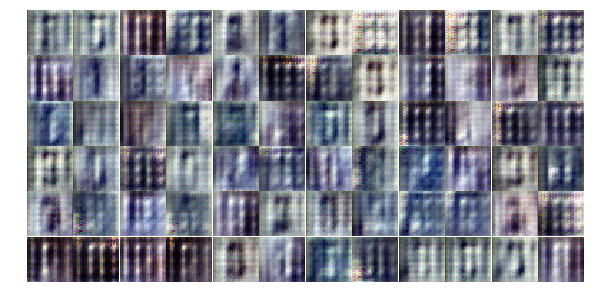

Epoch 1/24... Discriminator Loss: 0.6853... Generator Loss: 3.0312
Epoch 1/24... Discriminator Loss: 1.1543... Generator Loss: 1.1965
Epoch 1/24... Discriminator Loss: 1.4086... Generator Loss: 0.7048
Epoch 1/24... Discriminator Loss: 1.3629... Generator Loss: 0.9800
Epoch 1/24... Discriminator Loss: 1.1985... Generator Loss: 0.8016
Epoch 1/24... Discriminator Loss: 1.2418... Generator Loss: 1.0663
Epoch 1/24... Discriminator Loss: 0.5485... Generator Loss: 1.9768
Epoch 1/24... Discriminator Loss: 1.3636... Generator Loss: 0.5095
Epoch 1/24... Discriminator Loss: 2.1573... Generator Loss: 3.1115
Epoch 1/24... Discriminator Loss: 1.5777... Generator Loss: 0.8388


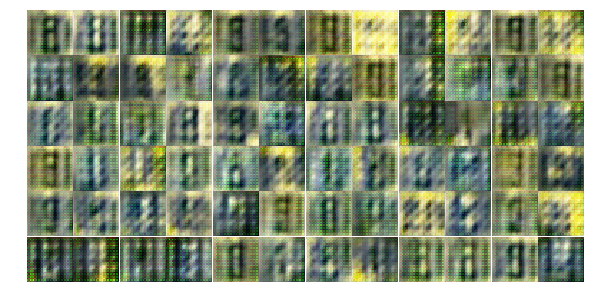

Epoch 1/24... Discriminator Loss: 0.8794... Generator Loss: 0.9277
Epoch 1/24... Discriminator Loss: 1.2819... Generator Loss: 0.8633
Epoch 1/24... Discriminator Loss: 1.4626... Generator Loss: 1.5999
Epoch 1/24... Discriminator Loss: 1.4445... Generator Loss: 0.7022
Epoch 1/24... Discriminator Loss: 1.3120... Generator Loss: 0.6924
Epoch 1/24... Discriminator Loss: 0.4607... Generator Loss: 1.9521
Epoch 1/24... Discriminator Loss: 1.0515... Generator Loss: 0.6782
Epoch 2/24... Discriminator Loss: 1.5167... Generator Loss: 0.9769
Epoch 2/24... Discriminator Loss: 1.1699... Generator Loss: 1.1847
Epoch 2/24... Discriminator Loss: 1.2194... Generator Loss: 0.6952


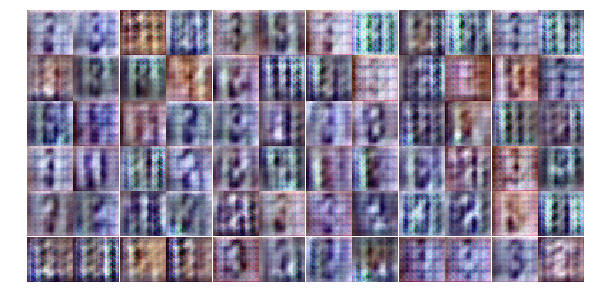

Epoch 2/24... Discriminator Loss: 0.7009... Generator Loss: 1.0706
Epoch 2/24... Discriminator Loss: 1.3050... Generator Loss: 0.6220
Epoch 2/24... Discriminator Loss: 1.2489... Generator Loss: 0.6936
Epoch 2/24... Discriminator Loss: 3.1303... Generator Loss: 4.1210
Epoch 2/24... Discriminator Loss: 1.3287... Generator Loss: 0.7298
Epoch 2/24... Discriminator Loss: 1.2873... Generator Loss: 0.9927
Epoch 2/24... Discriminator Loss: 1.3689... Generator Loss: 0.6776
Epoch 2/24... Discriminator Loss: 1.3842... Generator Loss: 0.8141
Epoch 2/24... Discriminator Loss: 1.0427... Generator Loss: 0.9086
Epoch 2/24... Discriminator Loss: 1.2609... Generator Loss: 2.0474


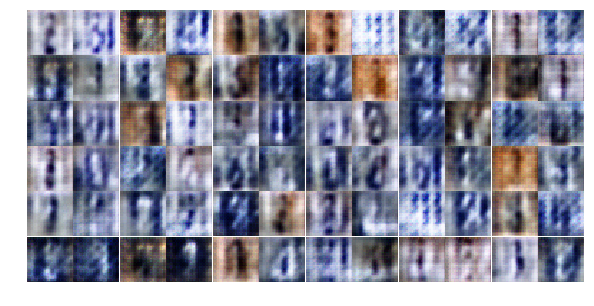

Epoch 2/24... Discriminator Loss: 1.1261... Generator Loss: 1.3523
Epoch 2/24... Discriminator Loss: 1.0100... Generator Loss: 1.0689
Epoch 2/24... Discriminator Loss: 1.4321... Generator Loss: 0.8776
Epoch 2/24... Discriminator Loss: 0.6029... Generator Loss: 1.3431
Epoch 2/24... Discriminator Loss: 1.2482... Generator Loss: 0.5635
Epoch 2/24... Discriminator Loss: 1.5650... Generator Loss: 0.7294
Epoch 2/24... Discriminator Loss: 1.2046... Generator Loss: 0.8556
Epoch 2/24... Discriminator Loss: 0.9109... Generator Loss: 1.0389
Epoch 2/24... Discriminator Loss: 1.1362... Generator Loss: 0.8872
Epoch 2/24... Discriminator Loss: 1.1852... Generator Loss: 0.7949


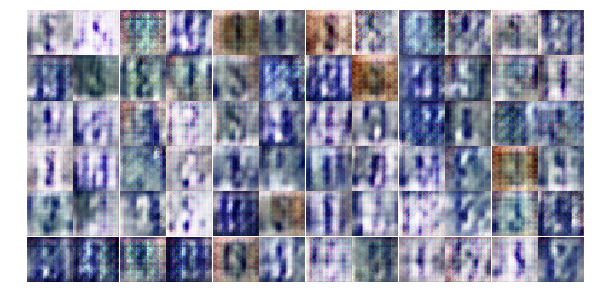

Epoch 2/24... Discriminator Loss: 1.0719... Generator Loss: 0.9710
Epoch 2/24... Discriminator Loss: 1.2724... Generator Loss: 0.7573
Epoch 2/24... Discriminator Loss: 1.0705... Generator Loss: 1.1125
Epoch 2/24... Discriminator Loss: 1.2597... Generator Loss: 0.7108
Epoch 2/24... Discriminator Loss: 1.2206... Generator Loss: 0.8891
Epoch 2/24... Discriminator Loss: 1.2626... Generator Loss: 1.6415
Epoch 2/24... Discriminator Loss: 1.1139... Generator Loss: 1.3652
Epoch 2/24... Discriminator Loss: 1.1947... Generator Loss: 0.9228
Epoch 2/24... Discriminator Loss: 1.2095... Generator Loss: 0.6850
Epoch 2/24... Discriminator Loss: 1.8711... Generator Loss: 2.6948


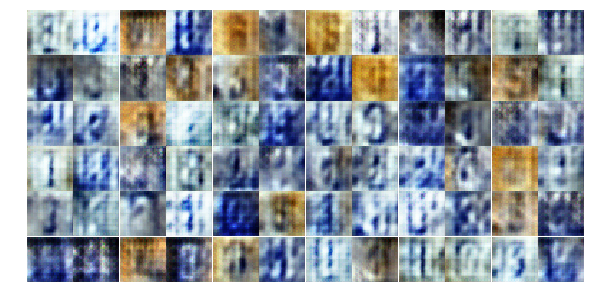

Epoch 2/24... Discriminator Loss: 1.4757... Generator Loss: 0.6549
Epoch 2/24... Discriminator Loss: 1.3545... Generator Loss: 0.8206
Epoch 2/24... Discriminator Loss: 1.2312... Generator Loss: 1.0562
Epoch 2/24... Discriminator Loss: 1.4218... Generator Loss: 0.6732
Epoch 2/24... Discriminator Loss: 1.1612... Generator Loss: 1.3438
Epoch 2/24... Discriminator Loss: 1.1539... Generator Loss: 0.9479
Epoch 2/24... Discriminator Loss: 1.1956... Generator Loss: 1.0396
Epoch 2/24... Discriminator Loss: 0.8469... Generator Loss: 1.3846
Epoch 2/24... Discriminator Loss: 1.3165... Generator Loss: 0.9866
Epoch 2/24... Discriminator Loss: 1.3468... Generator Loss: 0.6588


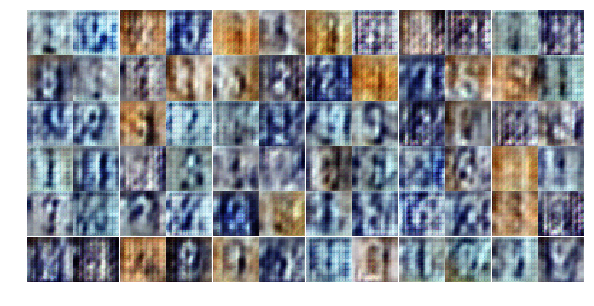

Epoch 2/24... Discriminator Loss: 1.2605... Generator Loss: 1.3328
Epoch 2/24... Discriminator Loss: 1.0345... Generator Loss: 1.0625
Epoch 2/24... Discriminator Loss: 1.2031... Generator Loss: 0.9926
Epoch 2/24... Discriminator Loss: 1.0575... Generator Loss: 0.9787
Epoch 2/24... Discriminator Loss: 1.4686... Generator Loss: 0.8954
Epoch 2/24... Discriminator Loss: 1.0993... Generator Loss: 1.0565
Epoch 2/24... Discriminator Loss: 1.1108... Generator Loss: 0.9349
Epoch 2/24... Discriminator Loss: 1.3786... Generator Loss: 0.6314
Epoch 2/24... Discriminator Loss: 1.0968... Generator Loss: 0.9969
Epoch 2/24... Discriminator Loss: 0.9852... Generator Loss: 1.0726


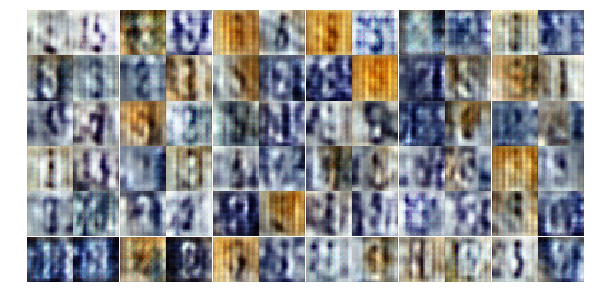

Epoch 2/24... Discriminator Loss: 1.2785... Generator Loss: 0.7351
Epoch 2/24... Discriminator Loss: 1.0428... Generator Loss: 0.9263
Epoch 2/24... Discriminator Loss: 1.0876... Generator Loss: 0.9150
Epoch 2/24... Discriminator Loss: 1.2511... Generator Loss: 1.0996
Epoch 3/24... Discriminator Loss: 1.0330... Generator Loss: 1.1652
Epoch 3/24... Discriminator Loss: 1.2475... Generator Loss: 0.6904
Epoch 3/24... Discriminator Loss: 1.3581... Generator Loss: 0.7861
Epoch 3/24... Discriminator Loss: 1.4076... Generator Loss: 0.7165
Epoch 3/24... Discriminator Loss: 1.0569... Generator Loss: 1.0194
Epoch 3/24... Discriminator Loss: 1.0414... Generator Loss: 1.0083


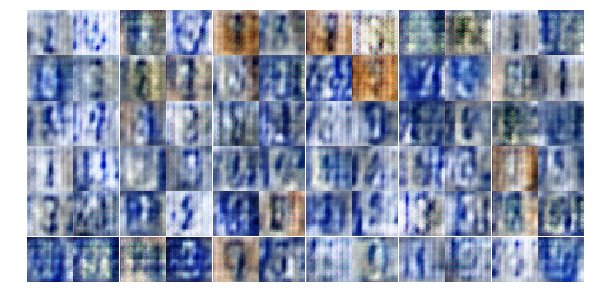

Epoch 3/24... Discriminator Loss: 1.4526... Generator Loss: 0.5933
Epoch 3/24... Discriminator Loss: 1.3604... Generator Loss: 0.6685
Epoch 3/24... Discriminator Loss: 1.3328... Generator Loss: 0.8278
Epoch 3/24... Discriminator Loss: 1.0797... Generator Loss: 1.0693
Epoch 3/24... Discriminator Loss: 1.3924... Generator Loss: 0.6096
Epoch 3/24... Discriminator Loss: 2.7315... Generator Loss: 4.1832
Epoch 3/24... Discriminator Loss: 1.2682... Generator Loss: 0.9905
Epoch 3/24... Discriminator Loss: 1.1829... Generator Loss: 1.3932
Epoch 3/24... Discriminator Loss: 1.1519... Generator Loss: 0.8843
Epoch 3/24... Discriminator Loss: 1.3104... Generator Loss: 0.7589


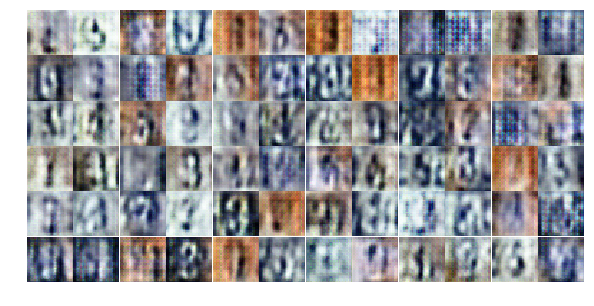

Epoch 3/24... Discriminator Loss: 1.1850... Generator Loss: 0.9011
Epoch 3/24... Discriminator Loss: 1.3791... Generator Loss: 0.6181
Epoch 3/24... Discriminator Loss: 1.2794... Generator Loss: 0.7638
Epoch 3/24... Discriminator Loss: 1.2256... Generator Loss: 0.8246
Epoch 3/24... Discriminator Loss: 1.2580... Generator Loss: 0.7907
Epoch 3/24... Discriminator Loss: 1.3313... Generator Loss: 0.8920
Epoch 3/24... Discriminator Loss: 1.2958... Generator Loss: 0.5400
Epoch 3/24... Discriminator Loss: 1.1821... Generator Loss: 0.7932
Epoch 3/24... Discriminator Loss: 1.3700... Generator Loss: 1.0537
Epoch 3/24... Discriminator Loss: 1.1287... Generator Loss: 0.9954


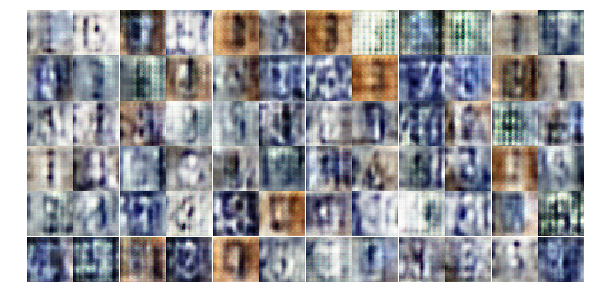

Epoch 3/24... Discriminator Loss: 1.3277... Generator Loss: 0.9266
Epoch 3/24... Discriminator Loss: 1.1813... Generator Loss: 0.9716
Epoch 3/24... Discriminator Loss: 1.2975... Generator Loss: 0.8598
Epoch 3/24... Discriminator Loss: 0.8953... Generator Loss: 0.9716
Epoch 3/24... Discriminator Loss: 1.1945... Generator Loss: 1.3909
Epoch 3/24... Discriminator Loss: 1.2466... Generator Loss: 0.7627
Epoch 3/24... Discriminator Loss: 1.2615... Generator Loss: 0.8532
Epoch 3/24... Discriminator Loss: 1.3497... Generator Loss: 0.7945
Epoch 3/24... Discriminator Loss: 1.4063... Generator Loss: 0.7662
Epoch 3/24... Discriminator Loss: 1.3489... Generator Loss: 0.7493


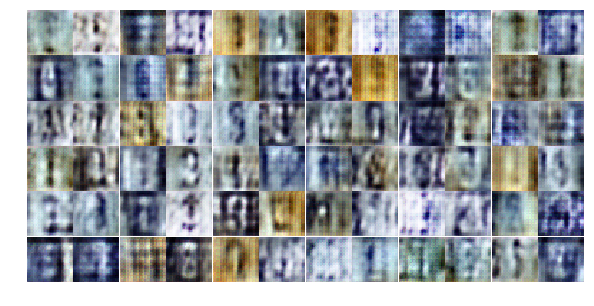

Epoch 3/24... Discriminator Loss: 1.3168... Generator Loss: 0.8964
Epoch 3/24... Discriminator Loss: 1.2957... Generator Loss: 0.8435
Epoch 3/24... Discriminator Loss: 1.3836... Generator Loss: 1.0133
Epoch 3/24... Discriminator Loss: 1.2804... Generator Loss: 0.8005
Epoch 3/24... Discriminator Loss: 1.2707... Generator Loss: 0.9653
Epoch 3/24... Discriminator Loss: 1.1618... Generator Loss: 0.8121
Epoch 3/24... Discriminator Loss: 1.3228... Generator Loss: 0.8921
Epoch 3/24... Discriminator Loss: 1.2336... Generator Loss: 0.9147
Epoch 3/24... Discriminator Loss: 1.2756... Generator Loss: 1.0544
Epoch 3/24... Discriminator Loss: 1.2580... Generator Loss: 0.8314


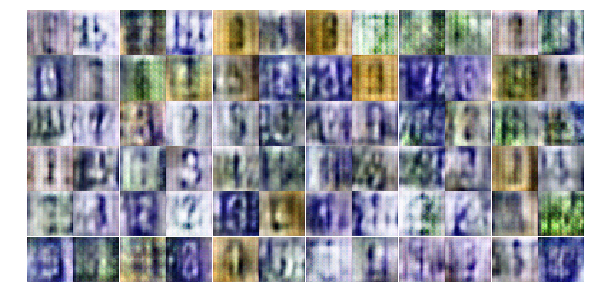

Epoch 3/24... Discriminator Loss: 1.2536... Generator Loss: 0.6878
Epoch 3/24... Discriminator Loss: 1.0965... Generator Loss: 1.3481
Epoch 3/24... Discriminator Loss: 1.1719... Generator Loss: 0.8671
Epoch 3/24... Discriminator Loss: 1.0862... Generator Loss: 1.0106
Epoch 3/24... Discriminator Loss: 1.3397... Generator Loss: 1.1075
Epoch 3/24... Discriminator Loss: 1.1749... Generator Loss: 1.0064
Epoch 3/24... Discriminator Loss: 1.1942... Generator Loss: 0.7362
Epoch 3/24... Discriminator Loss: 1.2015... Generator Loss: 0.8727
Epoch 3/24... Discriminator Loss: 1.3410... Generator Loss: 0.7481
Epoch 3/24... Discriminator Loss: 1.3849... Generator Loss: 0.9071


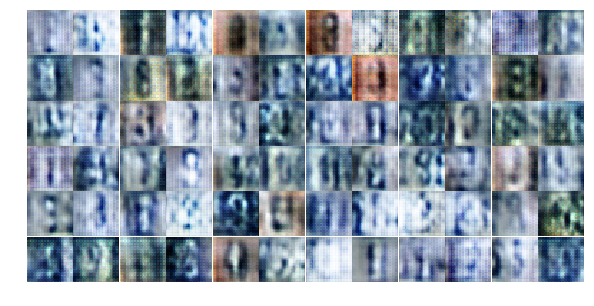

Epoch 3/24... Discriminator Loss: 1.5260... Generator Loss: 0.5602
Epoch 4/24... Discriminator Loss: 1.3910... Generator Loss: 1.0327
Epoch 4/24... Discriminator Loss: 1.1407... Generator Loss: 0.8599
Epoch 4/24... Discriminator Loss: 1.0579... Generator Loss: 0.8073
Epoch 4/24... Discriminator Loss: 1.1008... Generator Loss: 0.9960
Epoch 4/24... Discriminator Loss: 1.3810... Generator Loss: 0.7485
Epoch 4/24... Discriminator Loss: 1.2405... Generator Loss: 0.7303
Epoch 4/24... Discriminator Loss: 0.9493... Generator Loss: 1.4213
Epoch 4/24... Discriminator Loss: 1.2243... Generator Loss: 0.7988
Epoch 4/24... Discriminator Loss: 1.1922... Generator Loss: 0.7228


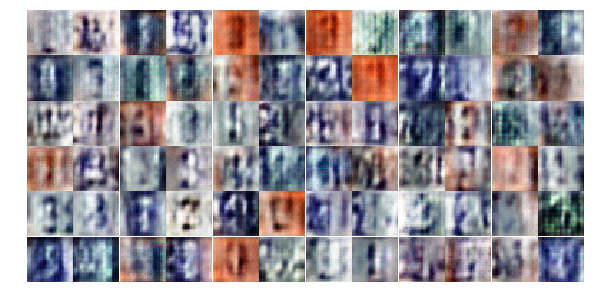

Epoch 4/24... Discriminator Loss: 1.1947... Generator Loss: 0.6642
Epoch 4/24... Discriminator Loss: 1.1745... Generator Loss: 0.7039
Epoch 4/24... Discriminator Loss: 1.2991... Generator Loss: 1.0540
Epoch 4/24... Discriminator Loss: 1.3184... Generator Loss: 0.6826
Epoch 4/24... Discriminator Loss: 1.2606... Generator Loss: 0.8209
Epoch 4/24... Discriminator Loss: 1.5415... Generator Loss: 0.4107
Epoch 4/24... Discriminator Loss: 1.3174... Generator Loss: 0.6788
Epoch 4/24... Discriminator Loss: 1.3861... Generator Loss: 0.7753
Epoch 4/24... Discriminator Loss: 1.2573... Generator Loss: 0.9819
Epoch 4/24... Discriminator Loss: 1.1052... Generator Loss: 0.7971


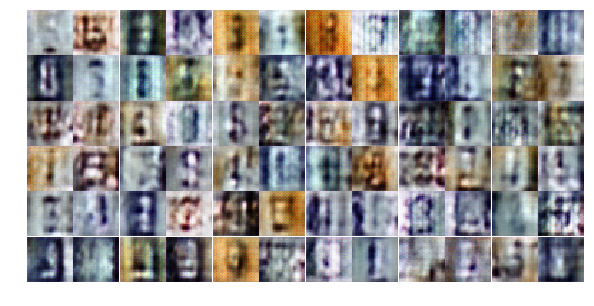

Epoch 4/24... Discriminator Loss: 1.2137... Generator Loss: 0.6436
Epoch 4/24... Discriminator Loss: 1.2094... Generator Loss: 0.8728
Epoch 4/24... Discriminator Loss: 0.6884... Generator Loss: 2.0146
Epoch 4/24... Discriminator Loss: 1.1437... Generator Loss: 1.0076
Epoch 4/24... Discriminator Loss: 1.2456... Generator Loss: 1.0014
Epoch 4/24... Discriminator Loss: 1.1076... Generator Loss: 1.3208
Epoch 4/24... Discriminator Loss: 1.1999... Generator Loss: 0.8079
Epoch 4/24... Discriminator Loss: 1.1577... Generator Loss: 0.9701
Epoch 4/24... Discriminator Loss: 1.4982... Generator Loss: 0.4771
Epoch 4/24... Discriminator Loss: 1.2872... Generator Loss: 0.6030


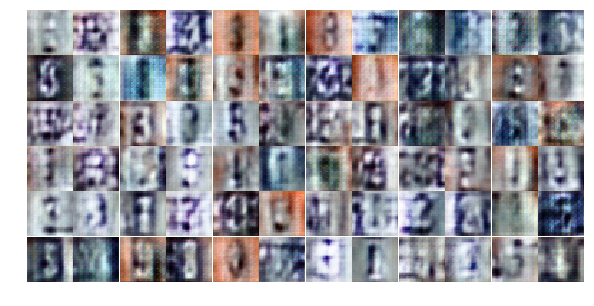

Epoch 4/24... Discriminator Loss: 0.9171... Generator Loss: 1.1824
Epoch 4/24... Discriminator Loss: 1.3163... Generator Loss: 0.7724
Epoch 4/24... Discriminator Loss: 0.5949... Generator Loss: 1.0068
Epoch 4/24... Discriminator Loss: 1.0910... Generator Loss: 0.7874
Epoch 4/24... Discriminator Loss: 1.5292... Generator Loss: 1.5413
Epoch 4/24... Discriminator Loss: 1.2469... Generator Loss: 0.8653
Epoch 4/24... Discriminator Loss: 1.2575... Generator Loss: 0.7226
Epoch 4/24... Discriminator Loss: 0.8706... Generator Loss: 0.9146
Epoch 4/24... Discriminator Loss: 1.1165... Generator Loss: 0.8934
Epoch 4/24... Discriminator Loss: 1.6439... Generator Loss: 0.3735


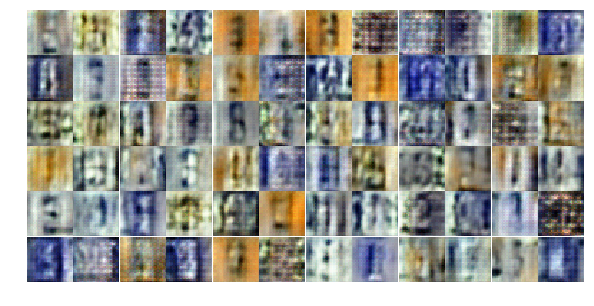

Epoch 4/24... Discriminator Loss: 1.0246... Generator Loss: 1.0008
Epoch 4/24... Discriminator Loss: 1.0521... Generator Loss: 0.9063
Epoch 4/24... Discriminator Loss: 0.7957... Generator Loss: 0.9463
Epoch 4/24... Discriminator Loss: 1.0014... Generator Loss: 0.9913
Epoch 4/24... Discriminator Loss: 1.0302... Generator Loss: 1.0308
Epoch 4/24... Discriminator Loss: 0.9499... Generator Loss: 1.1030
Epoch 4/24... Discriminator Loss: 1.0436... Generator Loss: 1.2250
Epoch 4/24... Discriminator Loss: 1.0362... Generator Loss: 1.1246
Epoch 4/24... Discriminator Loss: 1.1729... Generator Loss: 0.8066
Epoch 4/24... Discriminator Loss: 1.1354... Generator Loss: 1.1445


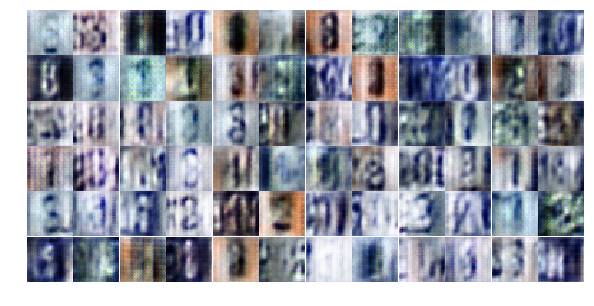

Epoch 4/24... Discriminator Loss: 1.0951... Generator Loss: 0.8694
Epoch 4/24... Discriminator Loss: 1.6072... Generator Loss: 2.1128
Epoch 4/24... Discriminator Loss: 1.1231... Generator Loss: 0.9503
Epoch 4/24... Discriminator Loss: 1.1870... Generator Loss: 1.3027
Epoch 4/24... Discriminator Loss: 0.8936... Generator Loss: 1.1149
Epoch 4/24... Discriminator Loss: 1.0503... Generator Loss: 0.9152
Epoch 4/24... Discriminator Loss: 1.0693... Generator Loss: 0.7590
Epoch 4/24... Discriminator Loss: 1.0939... Generator Loss: 0.9792
Epoch 4/24... Discriminator Loss: 1.8247... Generator Loss: 2.3839
Epoch 5/24... Discriminator Loss: 1.2980... Generator Loss: 0.5873


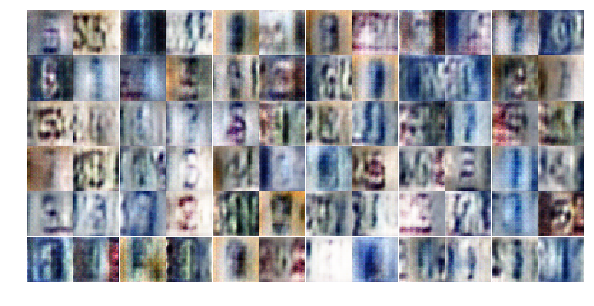

Epoch 5/24... Discriminator Loss: 1.0028... Generator Loss: 0.8100
Epoch 5/24... Discriminator Loss: 1.1794... Generator Loss: 0.6210
Epoch 5/24... Discriminator Loss: 0.7574... Generator Loss: 1.5135
Epoch 5/24... Discriminator Loss: 1.5337... Generator Loss: 0.3404
Epoch 5/24... Discriminator Loss: 0.9346... Generator Loss: 0.8155
Epoch 5/24... Discriminator Loss: 1.2646... Generator Loss: 0.6319
Epoch 5/24... Discriminator Loss: 2.1391... Generator Loss: 0.1710
Epoch 5/24... Discriminator Loss: 0.7326... Generator Loss: 1.5888
Epoch 5/24... Discriminator Loss: 0.7459... Generator Loss: 0.8545
Epoch 5/24... Discriminator Loss: 1.1194... Generator Loss: 0.9151


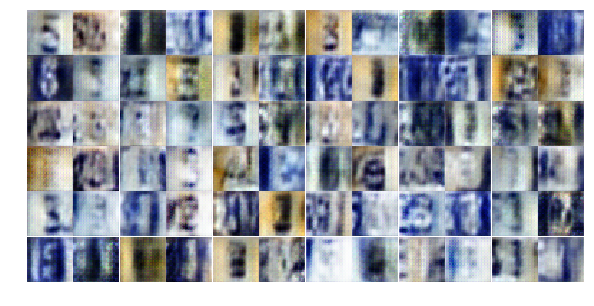

Epoch 5/24... Discriminator Loss: 1.0486... Generator Loss: 1.1533
Epoch 5/24... Discriminator Loss: 1.1061... Generator Loss: 1.8023
Epoch 5/24... Discriminator Loss: 1.2135... Generator Loss: 0.5693
Epoch 5/24... Discriminator Loss: 1.4010... Generator Loss: 0.6661
Epoch 5/24... Discriminator Loss: 1.2338... Generator Loss: 0.5598
Epoch 5/24... Discriminator Loss: 0.9903... Generator Loss: 0.7651
Epoch 5/24... Discriminator Loss: 0.8615... Generator Loss: 0.9779
Epoch 5/24... Discriminator Loss: 1.0470... Generator Loss: 2.0910
Epoch 5/24... Discriminator Loss: 1.2197... Generator Loss: 0.4777
Epoch 5/24... Discriminator Loss: 0.4843... Generator Loss: 2.2418


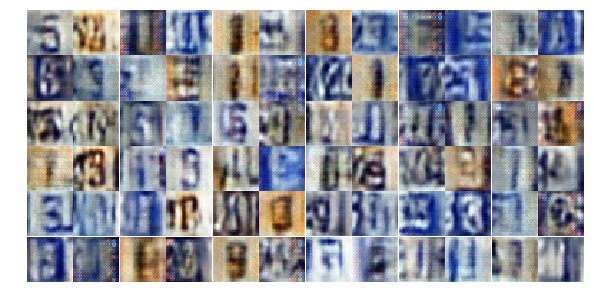

Epoch 5/24... Discriminator Loss: 1.0686... Generator Loss: 1.3337
Epoch 5/24... Discriminator Loss: 0.9232... Generator Loss: 1.0107
Epoch 5/24... Discriminator Loss: 0.5706... Generator Loss: 1.6105
Epoch 5/24... Discriminator Loss: 0.8841... Generator Loss: 1.0396
Epoch 5/24... Discriminator Loss: 2.1661... Generator Loss: 0.1603
Epoch 5/24... Discriminator Loss: 0.6752... Generator Loss: 1.1580
Epoch 5/24... Discriminator Loss: 1.8476... Generator Loss: 3.8292
Epoch 5/24... Discriminator Loss: 0.8380... Generator Loss: 0.9751
Epoch 5/24... Discriminator Loss: 0.6800... Generator Loss: 4.7997
Epoch 5/24... Discriminator Loss: 1.4738... Generator Loss: 7.0250


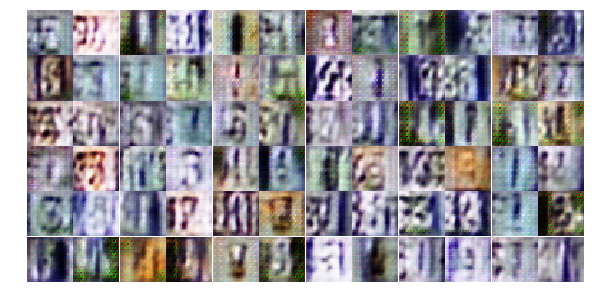

Epoch 5/24... Discriminator Loss: 0.6833... Generator Loss: 1.5847
Epoch 5/24... Discriminator Loss: 0.2118... Generator Loss: 3.8714
Epoch 5/24... Discriminator Loss: 0.2598... Generator Loss: 1.8594
Epoch 5/24... Discriminator Loss: 1.1109... Generator Loss: 1.5328
Epoch 5/24... Discriminator Loss: 0.6418... Generator Loss: 0.9947
Epoch 5/24... Discriminator Loss: 0.2011... Generator Loss: 3.6466
Epoch 5/24... Discriminator Loss: 1.3023... Generator Loss: 0.8375
Epoch 5/24... Discriminator Loss: 0.9355... Generator Loss: 3.0026
Epoch 5/24... Discriminator Loss: 1.1454... Generator Loss: 0.5568
Epoch 5/24... Discriminator Loss: 0.9179... Generator Loss: 3.4649


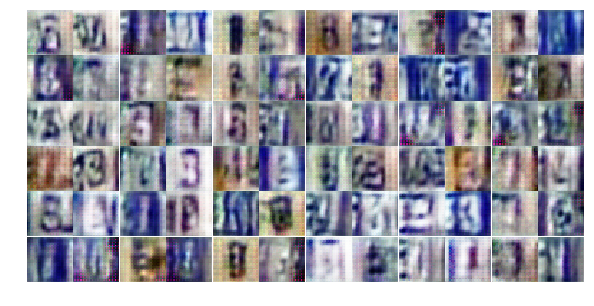

Epoch 5/24... Discriminator Loss: 0.8770... Generator Loss: 1.1792
Epoch 5/24... Discriminator Loss: 1.0085... Generator Loss: 0.6524
Epoch 5/24... Discriminator Loss: 1.3422... Generator Loss: 0.5683
Epoch 5/24... Discriminator Loss: 1.2788... Generator Loss: 0.8213
Epoch 5/24... Discriminator Loss: 0.7199... Generator Loss: 1.1398
Epoch 5/24... Discriminator Loss: 0.6732... Generator Loss: 2.0708
Epoch 5/24... Discriminator Loss: 0.9850... Generator Loss: 0.9110
Epoch 5/24... Discriminator Loss: 1.5592... Generator Loss: 2.8611
Epoch 5/24... Discriminator Loss: 0.5791... Generator Loss: 2.5388
Epoch 5/24... Discriminator Loss: 1.5867... Generator Loss: 1.7680


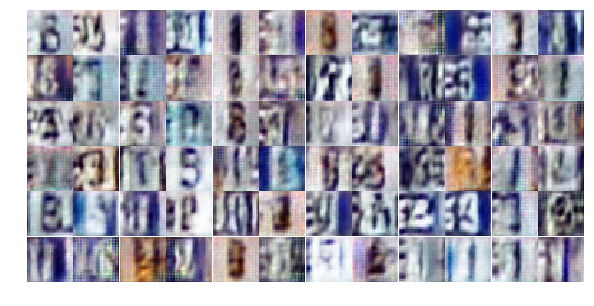

Epoch 5/24... Discriminator Loss: 2.1141... Generator Loss: 1.9970
Epoch 5/24... Discriminator Loss: 1.1063... Generator Loss: 0.9213
Epoch 5/24... Discriminator Loss: 1.6936... Generator Loss: 0.2704
Epoch 5/24... Discriminator Loss: 0.8192... Generator Loss: 1.0109
Epoch 5/24... Discriminator Loss: 1.0295... Generator Loss: 1.0524
Epoch 5/24... Discriminator Loss: 1.3137... Generator Loss: 0.5165
Epoch 6/24... Discriminator Loss: 1.0951... Generator Loss: 1.0919
Epoch 6/24... Discriminator Loss: 0.8179... Generator Loss: 1.1958
Epoch 6/24... Discriminator Loss: 0.4912... Generator Loss: 2.2213
Epoch 6/24... Discriminator Loss: 1.2806... Generator Loss: 0.9104


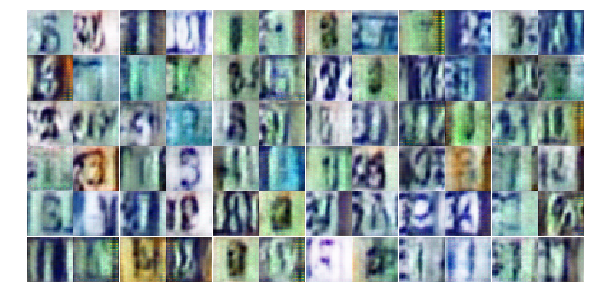

Epoch 6/24... Discriminator Loss: 1.0195... Generator Loss: 0.6093
Epoch 6/24... Discriminator Loss: 0.9037... Generator Loss: 0.7687
Epoch 6/24... Discriminator Loss: 1.5395... Generator Loss: 0.7254
Epoch 6/24... Discriminator Loss: 1.1178... Generator Loss: 0.8032
Epoch 6/24... Discriminator Loss: 1.1163... Generator Loss: 0.6317
Epoch 6/24... Discriminator Loss: 0.9664... Generator Loss: 0.6923
Epoch 6/24... Discriminator Loss: 1.8600... Generator Loss: 0.3017
Epoch 6/24... Discriminator Loss: 1.5049... Generator Loss: 0.4612
Epoch 6/24... Discriminator Loss: 0.8068... Generator Loss: 1.1594
Epoch 6/24... Discriminator Loss: 0.5998... Generator Loss: 1.3335


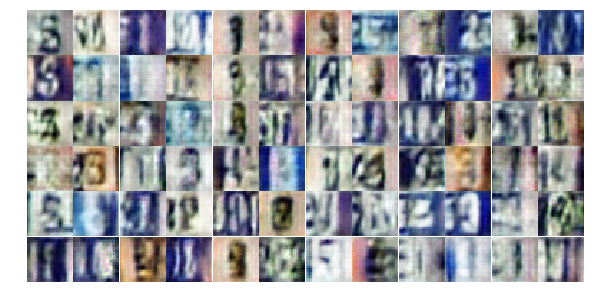

Epoch 6/24... Discriminator Loss: 1.1952... Generator Loss: 0.5896
Epoch 6/24... Discriminator Loss: 1.0151... Generator Loss: 0.8082
Epoch 6/24... Discriminator Loss: 1.1909... Generator Loss: 0.4787
Epoch 6/24... Discriminator Loss: 0.9274... Generator Loss: 2.0823
Epoch 6/24... Discriminator Loss: 0.8525... Generator Loss: 1.0820
Epoch 6/24... Discriminator Loss: 0.8081... Generator Loss: 1.9173
Epoch 6/24... Discriminator Loss: 1.2579... Generator Loss: 0.8425
Epoch 6/24... Discriminator Loss: 0.7414... Generator Loss: 1.3333
Epoch 6/24... Discriminator Loss: 1.0865... Generator Loss: 0.9605
Epoch 6/24... Discriminator Loss: 0.6853... Generator Loss: 1.6872


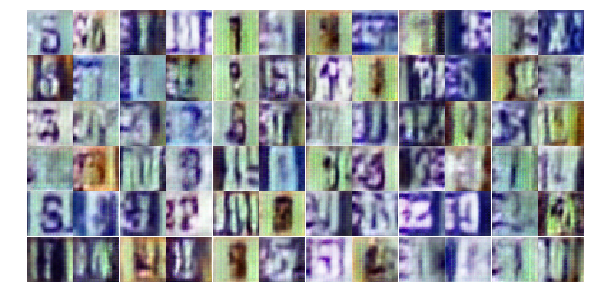

Epoch 6/24... Discriminator Loss: 2.3604... Generator Loss: 2.9066
Epoch 6/24... Discriminator Loss: 0.3922... Generator Loss: 1.8589
Epoch 6/24... Discriminator Loss: 1.2256... Generator Loss: 0.5677
Epoch 6/24... Discriminator Loss: 1.0240... Generator Loss: 0.9395
Epoch 6/24... Discriminator Loss: 1.6513... Generator Loss: 0.3845
Epoch 6/24... Discriminator Loss: 0.6129... Generator Loss: 1.2457
Epoch 6/24... Discriminator Loss: 1.5031... Generator Loss: 0.7780
Epoch 6/24... Discriminator Loss: 1.2573... Generator Loss: 0.7156
Epoch 6/24... Discriminator Loss: 1.1740... Generator Loss: 0.6717
Epoch 6/24... Discriminator Loss: 1.0670... Generator Loss: 0.8382


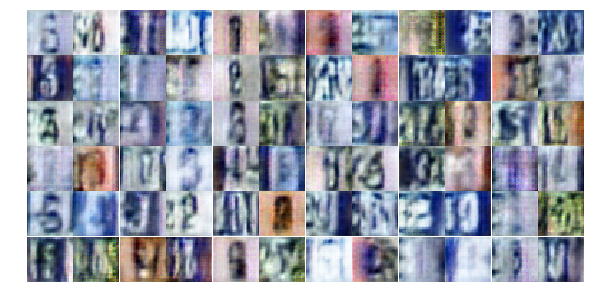

Epoch 6/24... Discriminator Loss: 0.8772... Generator Loss: 0.7827
Epoch 6/24... Discriminator Loss: 1.2440... Generator Loss: 0.6903
Epoch 6/24... Discriminator Loss: 0.9905... Generator Loss: 1.0304
Epoch 6/24... Discriminator Loss: 0.8959... Generator Loss: 1.0032
Epoch 6/24... Discriminator Loss: 1.0548... Generator Loss: 0.6382
Epoch 6/24... Discriminator Loss: 1.6566... Generator Loss: 0.9606
Epoch 6/24... Discriminator Loss: 0.2906... Generator Loss: 4.0583
Epoch 6/24... Discriminator Loss: 1.3499... Generator Loss: 0.7616
Epoch 6/24... Discriminator Loss: 1.2426... Generator Loss: 1.7168
Epoch 6/24... Discriminator Loss: 1.3009... Generator Loss: 0.4642


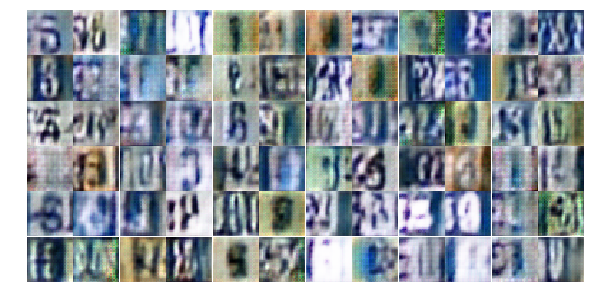

Epoch 6/24... Discriminator Loss: 1.2390... Generator Loss: 0.7179
Epoch 6/24... Discriminator Loss: 1.5718... Generator Loss: 0.4685
Epoch 6/24... Discriminator Loss: 1.4812... Generator Loss: 0.4129
Epoch 6/24... Discriminator Loss: 2.3994... Generator Loss: 2.5196
Epoch 6/24... Discriminator Loss: 0.9836... Generator Loss: 1.2909
Epoch 6/24... Discriminator Loss: 0.4390... Generator Loss: 1.6259
Epoch 6/24... Discriminator Loss: 1.1147... Generator Loss: 1.0091
Epoch 6/24... Discriminator Loss: 1.6813... Generator Loss: 0.2893
Epoch 6/24... Discriminator Loss: 1.0068... Generator Loss: 0.8323
Epoch 6/24... Discriminator Loss: 0.8093... Generator Loss: 1.0450


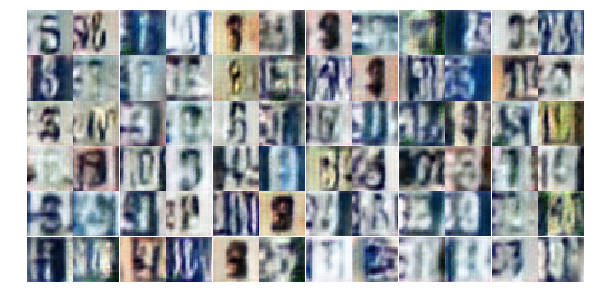

Epoch 6/24... Discriminator Loss: 1.7362... Generator Loss: 0.3354
Epoch 6/24... Discriminator Loss: 1.0208... Generator Loss: 0.7790
Epoch 6/24... Discriminator Loss: 1.2651... Generator Loss: 0.7899
Epoch 7/24... Discriminator Loss: 0.8959... Generator Loss: 1.1084
Epoch 7/24... Discriminator Loss: 0.9553... Generator Loss: 0.9101
Epoch 7/24... Discriminator Loss: 0.7416... Generator Loss: 1.6777
Epoch 7/24... Discriminator Loss: 0.7712... Generator Loss: 1.1670
Epoch 7/24... Discriminator Loss: 0.9743... Generator Loss: 0.8563
Epoch 7/24... Discriminator Loss: 1.0379... Generator Loss: 0.9032
Epoch 7/24... Discriminator Loss: 1.1178... Generator Loss: 0.7361


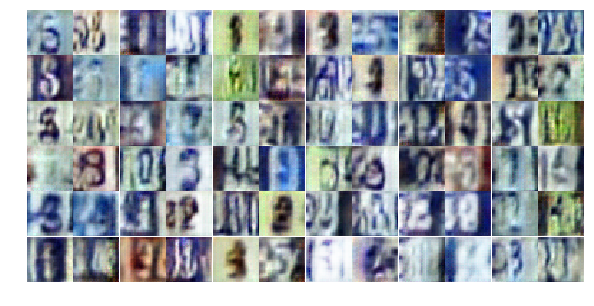

Epoch 7/24... Discriminator Loss: 1.0088... Generator Loss: 0.8167
Epoch 7/24... Discriminator Loss: 1.1222... Generator Loss: 0.5649
Epoch 7/24... Discriminator Loss: 1.0790... Generator Loss: 0.6773
Epoch 7/24... Discriminator Loss: 2.2079... Generator Loss: 0.1871
Epoch 7/24... Discriminator Loss: 0.9479... Generator Loss: 0.8321
Epoch 7/24... Discriminator Loss: 0.6588... Generator Loss: 1.4611
Epoch 7/24... Discriminator Loss: 1.2127... Generator Loss: 0.6519
Epoch 7/24... Discriminator Loss: 0.8784... Generator Loss: 1.3080
Epoch 7/24... Discriminator Loss: 1.3020... Generator Loss: 1.4810
Epoch 7/24... Discriminator Loss: 1.1553... Generator Loss: 1.0371


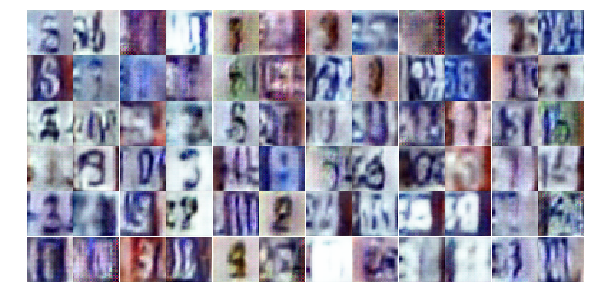

Epoch 7/24... Discriminator Loss: 0.9788... Generator Loss: 1.2022
Epoch 7/24... Discriminator Loss: 0.9840... Generator Loss: 1.2567
Epoch 7/24... Discriminator Loss: 1.6258... Generator Loss: 0.8268
Epoch 7/24... Discriminator Loss: 1.2301... Generator Loss: 1.0400
Epoch 7/24... Discriminator Loss: 1.1039... Generator Loss: 1.2963
Epoch 7/24... Discriminator Loss: 1.1750... Generator Loss: 0.8757
Epoch 7/24... Discriminator Loss: 1.1851... Generator Loss: 0.6391
Epoch 7/24... Discriminator Loss: 1.2786... Generator Loss: 0.7038
Epoch 7/24... Discriminator Loss: 0.9391... Generator Loss: 0.9942
Epoch 7/24... Discriminator Loss: 1.1807... Generator Loss: 0.8592


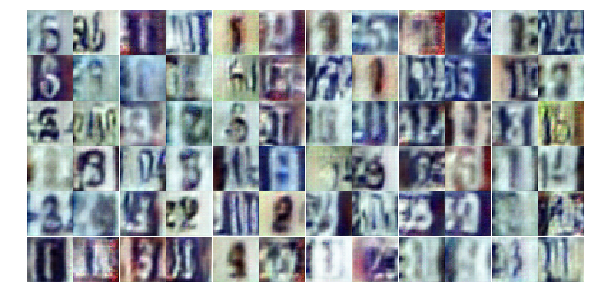

Epoch 7/24... Discriminator Loss: 1.3912... Generator Loss: 0.4140
Epoch 7/24... Discriminator Loss: 1.9242... Generator Loss: 0.2186
Epoch 7/24... Discriminator Loss: 1.2925... Generator Loss: 0.5432
Epoch 7/24... Discriminator Loss: 1.2471... Generator Loss: 0.6364
Epoch 7/24... Discriminator Loss: 1.1317... Generator Loss: 0.7556
Epoch 7/24... Discriminator Loss: 1.1676... Generator Loss: 0.5897
Epoch 7/24... Discriminator Loss: 0.9674... Generator Loss: 0.9446
Epoch 7/24... Discriminator Loss: 1.1925... Generator Loss: 0.8874
Epoch 7/24... Discriminator Loss: 1.5681... Generator Loss: 0.3445
Epoch 7/24... Discriminator Loss: 1.1804... Generator Loss: 0.8983


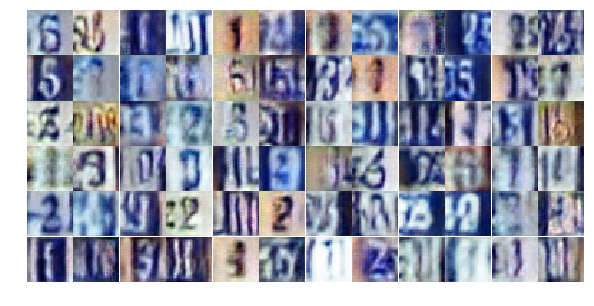

Epoch 7/24... Discriminator Loss: 1.3824... Generator Loss: 0.5158
Epoch 7/24... Discriminator Loss: 1.1903... Generator Loss: 0.5933
Epoch 7/24... Discriminator Loss: 1.4925... Generator Loss: 1.2862
Epoch 7/24... Discriminator Loss: 1.3006... Generator Loss: 0.4898
Epoch 7/24... Discriminator Loss: 0.6120... Generator Loss: 1.2792
Epoch 7/24... Discriminator Loss: 0.9415... Generator Loss: 1.0342
Epoch 7/24... Discriminator Loss: 1.0444... Generator Loss: 0.7357
Epoch 7/24... Discriminator Loss: 1.4315... Generator Loss: 0.4328
Epoch 7/24... Discriminator Loss: 1.1518... Generator Loss: 0.8398
Epoch 7/24... Discriminator Loss: 1.6354... Generator Loss: 0.3399


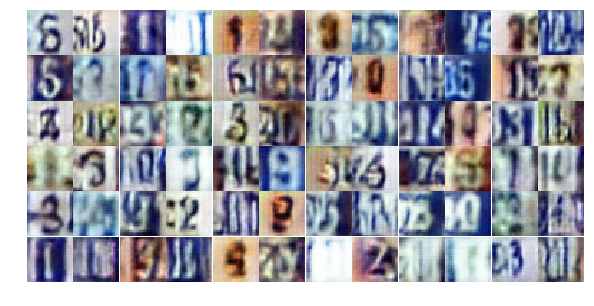

Epoch 7/24... Discriminator Loss: 0.7830... Generator Loss: 1.0619
Epoch 7/24... Discriminator Loss: 1.5573... Generator Loss: 0.3555
Epoch 7/24... Discriminator Loss: 0.7157... Generator Loss: 1.1511
Epoch 7/24... Discriminator Loss: 1.2224... Generator Loss: 1.1672
Epoch 7/24... Discriminator Loss: 1.1297... Generator Loss: 0.6965
Epoch 7/24... Discriminator Loss: 0.8264... Generator Loss: 1.6386
Epoch 7/24... Discriminator Loss: 1.4235... Generator Loss: 0.4020
Epoch 7/24... Discriminator Loss: 0.8952... Generator Loss: 2.1000
Epoch 7/24... Discriminator Loss: 1.1141... Generator Loss: 0.5933
Epoch 7/24... Discriminator Loss: 0.4907... Generator Loss: 1.3667


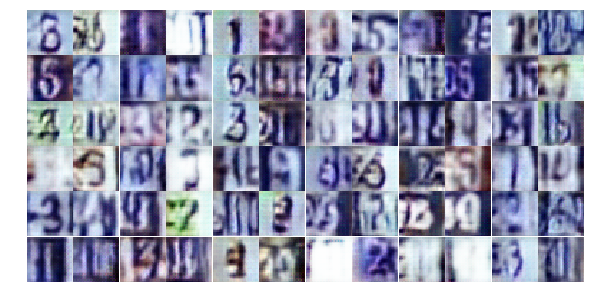

Epoch 7/24... Discriminator Loss: 1.2825... Generator Loss: 1.8261
Epoch 8/24... Discriminator Loss: 1.1340... Generator Loss: 1.1693
Epoch 8/24... Discriminator Loss: 1.1033... Generator Loss: 0.8396
Epoch 8/24... Discriminator Loss: 1.0857... Generator Loss: 0.8137
Epoch 8/24... Discriminator Loss: 1.1520... Generator Loss: 0.7147
Epoch 8/24... Discriminator Loss: 1.5141... Generator Loss: 0.4938
Epoch 8/24... Discriminator Loss: 1.2829... Generator Loss: 0.5651
Epoch 8/24... Discriminator Loss: 1.0633... Generator Loss: 0.8909
Epoch 8/24... Discriminator Loss: 1.1609... Generator Loss: 0.7696
Epoch 8/24... Discriminator Loss: 0.8760... Generator Loss: 0.6929


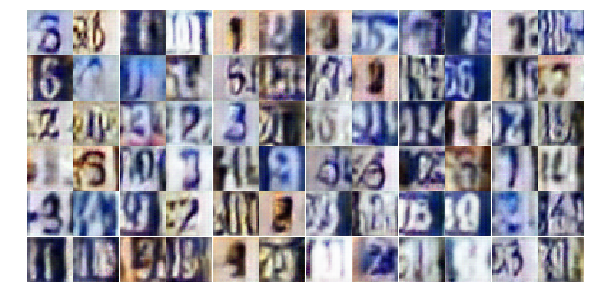

Epoch 8/24... Discriminator Loss: 1.1614... Generator Loss: 0.6623
Epoch 8/24... Discriminator Loss: 0.9892... Generator Loss: 0.6581
Epoch 8/24... Discriminator Loss: 1.7229... Generator Loss: 0.2668
Epoch 8/24... Discriminator Loss: 1.6673... Generator Loss: 0.3474
Epoch 8/24... Discriminator Loss: 1.2062... Generator Loss: 0.7183
Epoch 8/24... Discriminator Loss: 1.0944... Generator Loss: 0.9214
Epoch 8/24... Discriminator Loss: 1.2727... Generator Loss: 1.8913
Epoch 8/24... Discriminator Loss: 0.9934... Generator Loss: 0.8942
Epoch 8/24... Discriminator Loss: 0.8342... Generator Loss: 1.6374
Epoch 8/24... Discriminator Loss: 1.2968... Generator Loss: 0.5694


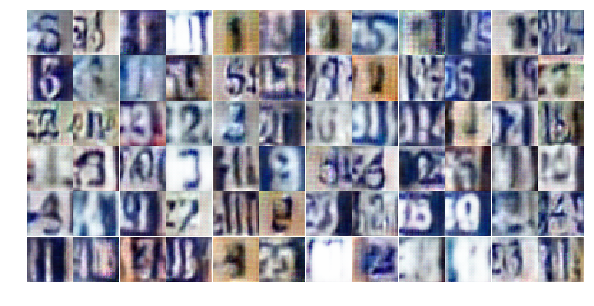

Epoch 8/24... Discriminator Loss: 1.0284... Generator Loss: 0.7450
Epoch 8/24... Discriminator Loss: 0.2026... Generator Loss: 2.4086
Epoch 8/24... Discriminator Loss: 1.0928... Generator Loss: 0.9964
Epoch 8/24... Discriminator Loss: 1.1985... Generator Loss: 0.7074
Epoch 8/24... Discriminator Loss: 0.5453... Generator Loss: 1.5856
Epoch 8/24... Discriminator Loss: 1.1644... Generator Loss: 1.2157
Epoch 8/24... Discriminator Loss: 1.1099... Generator Loss: 1.1593
Epoch 8/24... Discriminator Loss: 0.9513... Generator Loss: 0.9452
Epoch 8/24... Discriminator Loss: 1.2087... Generator Loss: 0.7133
Epoch 8/24... Discriminator Loss: 0.7001... Generator Loss: 1.2963


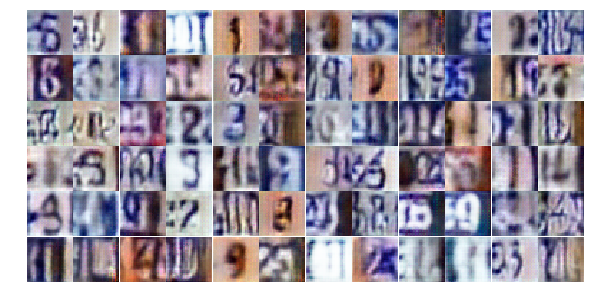

Epoch 8/24... Discriminator Loss: 0.3267... Generator Loss: 1.7641
Epoch 8/24... Discriminator Loss: 0.7411... Generator Loss: 1.7089
Epoch 8/24... Discriminator Loss: 0.9483... Generator Loss: 1.1358
Epoch 8/24... Discriminator Loss: 1.1991... Generator Loss: 0.5765
Epoch 8/24... Discriminator Loss: 0.5601... Generator Loss: 1.6057
Epoch 8/24... Discriminator Loss: 0.8815... Generator Loss: 0.9444
Epoch 8/24... Discriminator Loss: 0.9899... Generator Loss: 0.6649
Epoch 8/24... Discriminator Loss: 0.9667... Generator Loss: 0.7404
Epoch 8/24... Discriminator Loss: 1.0059... Generator Loss: 0.9069
Epoch 8/24... Discriminator Loss: 0.9404... Generator Loss: 1.3065


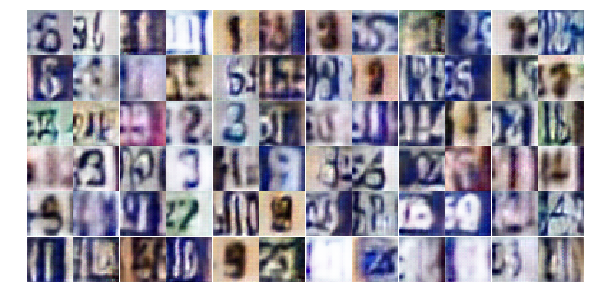

Epoch 8/24... Discriminator Loss: 1.1867... Generator Loss: 0.9060
Epoch 8/24... Discriminator Loss: 0.6697... Generator Loss: 1.3698
Epoch 8/24... Discriminator Loss: 0.9290... Generator Loss: 0.8391
Epoch 8/24... Discriminator Loss: 0.1528... Generator Loss: 3.2533
Epoch 8/24... Discriminator Loss: 1.5815... Generator Loss: 1.5811
Epoch 8/24... Discriminator Loss: 1.3204... Generator Loss: 0.5665
Epoch 8/24... Discriminator Loss: 0.7664... Generator Loss: 1.5936
Epoch 8/24... Discriminator Loss: 1.0873... Generator Loss: 0.8493
Epoch 8/24... Discriminator Loss: 1.1358... Generator Loss: 0.5991
Epoch 8/24... Discriminator Loss: 1.2139... Generator Loss: 0.8287


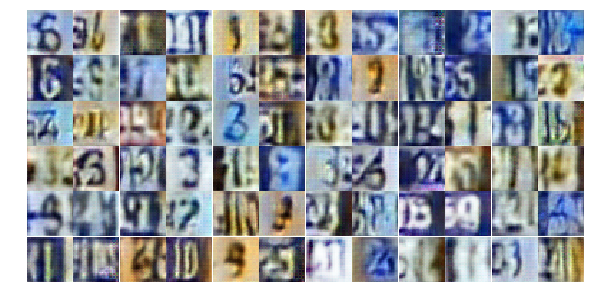

Epoch 8/24... Discriminator Loss: 0.7467... Generator Loss: 1.5255
Epoch 8/24... Discriminator Loss: 0.5662... Generator Loss: 2.5015
Epoch 8/24... Discriminator Loss: 1.2762... Generator Loss: 0.5032
Epoch 8/24... Discriminator Loss: 1.2386... Generator Loss: 0.7321
Epoch 8/24... Discriminator Loss: 0.9288... Generator Loss: 1.6181
Epoch 8/24... Discriminator Loss: 0.6992... Generator Loss: 1.6238
Epoch 8/24... Discriminator Loss: 1.0280... Generator Loss: 1.0234
Epoch 8/24... Discriminator Loss: 1.2161... Generator Loss: 0.9727
Epoch 9/24... Discriminator Loss: 1.3824... Generator Loss: 0.5711
Epoch 9/24... Discriminator Loss: 1.0566... Generator Loss: 0.6755


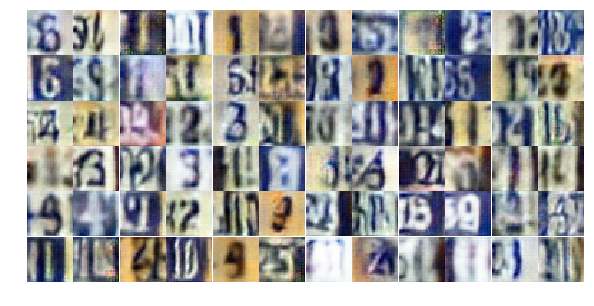

Epoch 9/24... Discriminator Loss: 0.8424... Generator Loss: 1.3462
Epoch 9/24... Discriminator Loss: 2.2427... Generator Loss: 0.3375
Epoch 9/24... Discriminator Loss: 1.2701... Generator Loss: 0.7012
Epoch 9/24... Discriminator Loss: 0.6786... Generator Loss: 1.1413
Epoch 9/24... Discriminator Loss: 1.8380... Generator Loss: 1.0132
Epoch 9/24... Discriminator Loss: 1.1011... Generator Loss: 1.2203
Epoch 9/24... Discriminator Loss: 1.0610... Generator Loss: 0.9412
Epoch 9/24... Discriminator Loss: 1.0597... Generator Loss: 0.6852
Epoch 9/24... Discriminator Loss: 1.1709... Generator Loss: 0.6538
Epoch 9/24... Discriminator Loss: 1.0039... Generator Loss: 0.8978


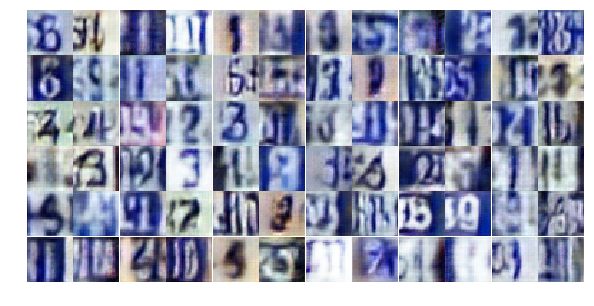

Epoch 9/24... Discriminator Loss: 1.2393... Generator Loss: 0.8695
Epoch 9/24... Discriminator Loss: 3.1685... Generator Loss: 0.0592
Epoch 9/24... Discriminator Loss: 1.0966... Generator Loss: 0.6192
Epoch 9/24... Discriminator Loss: 1.0323... Generator Loss: 0.8154
Epoch 9/24... Discriminator Loss: 0.9118... Generator Loss: 1.4148
Epoch 9/24... Discriminator Loss: 1.0711... Generator Loss: 0.6531
Epoch 9/24... Discriminator Loss: 1.4257... Generator Loss: 0.4602
Epoch 9/24... Discriminator Loss: 1.4286... Generator Loss: 0.4349
Epoch 9/24... Discriminator Loss: 1.1466... Generator Loss: 0.9004
Epoch 9/24... Discriminator Loss: 0.9096... Generator Loss: 0.9610


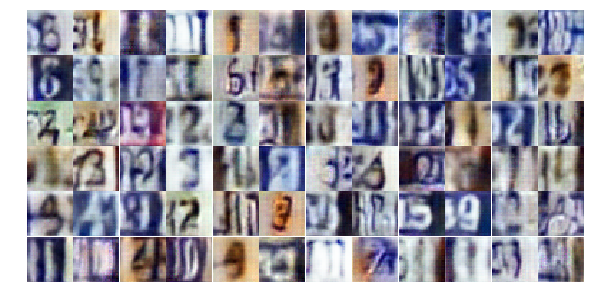

Epoch 9/24... Discriminator Loss: 1.1294... Generator Loss: 0.8135
Epoch 9/24... Discriminator Loss: 1.1883... Generator Loss: 0.4823
Epoch 9/24... Discriminator Loss: 0.5150... Generator Loss: 1.8322
Epoch 9/24... Discriminator Loss: 0.9943... Generator Loss: 1.7613
Epoch 9/24... Discriminator Loss: 1.0775... Generator Loss: 0.5991
Epoch 9/24... Discriminator Loss: 0.5877... Generator Loss: 2.4339
Epoch 9/24... Discriminator Loss: 1.0084... Generator Loss: 1.8420
Epoch 9/24... Discriminator Loss: 0.5056... Generator Loss: 2.8901
Epoch 9/24... Discriminator Loss: 0.9133... Generator Loss: 1.8157
Epoch 9/24... Discriminator Loss: 0.9833... Generator Loss: 1.3057


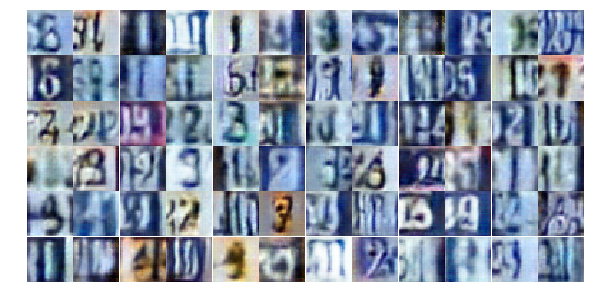

Epoch 9/24... Discriminator Loss: 1.1442... Generator Loss: 0.7567
Epoch 9/24... Discriminator Loss: 1.2724... Generator Loss: 0.6988
Epoch 9/24... Discriminator Loss: 1.1905... Generator Loss: 0.6433
Epoch 9/24... Discriminator Loss: 1.0949... Generator Loss: 0.7391
Epoch 9/24... Discriminator Loss: 0.8168... Generator Loss: 1.0983
Epoch 9/24... Discriminator Loss: 1.7659... Generator Loss: 0.2402
Epoch 9/24... Discriminator Loss: 0.1162... Generator Loss: 2.9265
Epoch 9/24... Discriminator Loss: 0.3193... Generator Loss: 1.9159
Epoch 9/24... Discriminator Loss: 2.2537... Generator Loss: 1.1561
Epoch 9/24... Discriminator Loss: 1.2177... Generator Loss: 0.7778


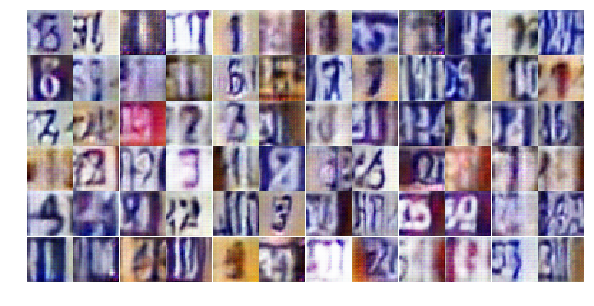

Epoch 9/24... Discriminator Loss: 0.9157... Generator Loss: 1.2300
Epoch 9/24... Discriminator Loss: 1.2794... Generator Loss: 0.6944
Epoch 9/24... Discriminator Loss: 1.0039... Generator Loss: 0.8963
Epoch 9/24... Discriminator Loss: 1.1309... Generator Loss: 1.0368
Epoch 9/24... Discriminator Loss: 0.9598... Generator Loss: 0.9593
Epoch 9/24... Discriminator Loss: 1.2163... Generator Loss: 0.6911
Epoch 9/24... Discriminator Loss: 0.9660... Generator Loss: 0.8990
Epoch 9/24... Discriminator Loss: 1.2085... Generator Loss: 0.6287
Epoch 9/24... Discriminator Loss: 1.2333... Generator Loss: 0.7720
Epoch 9/24... Discriminator Loss: 1.1893... Generator Loss: 1.0973


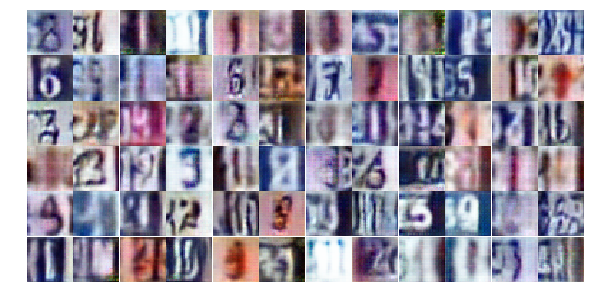

Epoch 9/24... Discriminator Loss: 1.2385... Generator Loss: 0.6103
Epoch 9/24... Discriminator Loss: 1.1495... Generator Loss: 0.9480
Epoch 9/24... Discriminator Loss: 1.0913... Generator Loss: 0.7689
Epoch 9/24... Discriminator Loss: 1.1108... Generator Loss: 0.7002
Epoch 9/24... Discriminator Loss: 1.0624... Generator Loss: 0.9051
Epoch 10/24... Discriminator Loss: 1.1184... Generator Loss: 0.7627
Epoch 10/24... Discriminator Loss: 1.1250... Generator Loss: 0.8108
Epoch 10/24... Discriminator Loss: 1.1775... Generator Loss: 0.5786
Epoch 10/24... Discriminator Loss: 1.1569... Generator Loss: 0.6264
Epoch 10/24... Discriminator Loss: 1.3216... Generator Loss: 0.4853


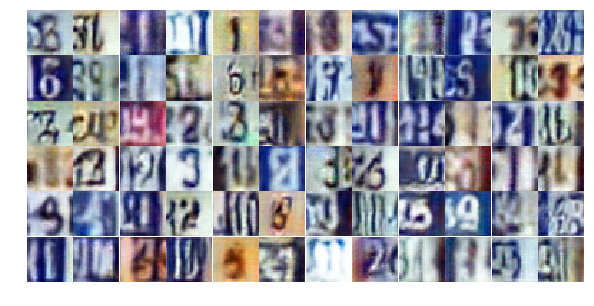

Epoch 10/24... Discriminator Loss: 1.2340... Generator Loss: 0.5952
Epoch 10/24... Discriminator Loss: 0.9454... Generator Loss: 1.0074
Epoch 10/24... Discriminator Loss: 1.0813... Generator Loss: 0.8243
Epoch 10/24... Discriminator Loss: 1.1368... Generator Loss: 0.8523
Epoch 10/24... Discriminator Loss: 1.1239... Generator Loss: 0.9182
Epoch 10/24... Discriminator Loss: 1.0713... Generator Loss: 0.9078
Epoch 10/24... Discriminator Loss: 1.0374... Generator Loss: 1.0185
Epoch 10/24... Discriminator Loss: 1.3993... Generator Loss: 0.4703
Epoch 10/24... Discriminator Loss: 1.3155... Generator Loss: 0.7174
Epoch 10/24... Discriminator Loss: 1.0196... Generator Loss: 1.3119


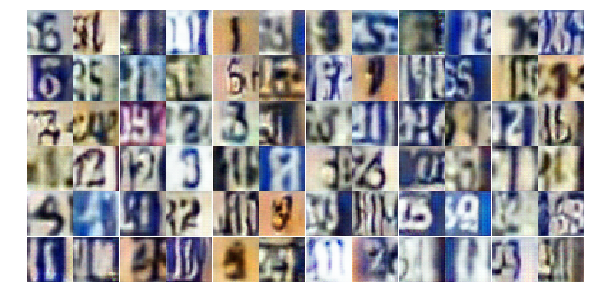

Epoch 10/24... Discriminator Loss: 1.1835... Generator Loss: 0.7427
Epoch 10/24... Discriminator Loss: 1.5245... Generator Loss: 0.4454
Epoch 10/24... Discriminator Loss: 1.0417... Generator Loss: 0.7939
Epoch 10/24... Discriminator Loss: 1.4387... Generator Loss: 0.4949
Epoch 10/24... Discriminator Loss: 1.0089... Generator Loss: 0.9364
Epoch 10/24... Discriminator Loss: 1.1933... Generator Loss: 0.6630
Epoch 10/24... Discriminator Loss: 1.0874... Generator Loss: 0.8061
Epoch 10/24... Discriminator Loss: 1.0173... Generator Loss: 0.7784
Epoch 10/24... Discriminator Loss: 1.3167... Generator Loss: 0.4972
Epoch 10/24... Discriminator Loss: 0.8128... Generator Loss: 1.2380


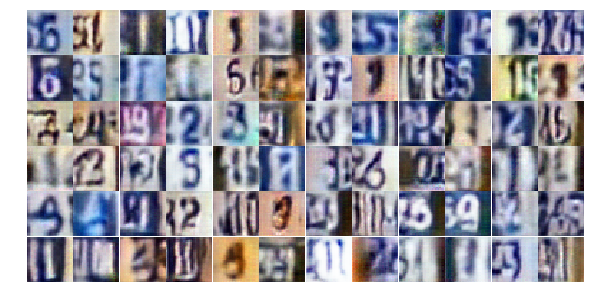

Epoch 10/24... Discriminator Loss: 1.1787... Generator Loss: 0.7068
Epoch 10/24... Discriminator Loss: 1.2076... Generator Loss: 0.8103
Epoch 10/24... Discriminator Loss: 1.0168... Generator Loss: 1.2595
Epoch 10/24... Discriminator Loss: 1.1446... Generator Loss: 1.7152
Epoch 10/24... Discriminator Loss: 1.3411... Generator Loss: 0.4307
Epoch 10/24... Discriminator Loss: 1.1068... Generator Loss: 0.6729
Epoch 10/24... Discriminator Loss: 0.9557... Generator Loss: 0.9761
Epoch 10/24... Discriminator Loss: 1.2377... Generator Loss: 0.5334
Epoch 10/24... Discriminator Loss: 0.9916... Generator Loss: 0.8221
Epoch 10/24... Discriminator Loss: 1.3775... Generator Loss: 0.4449


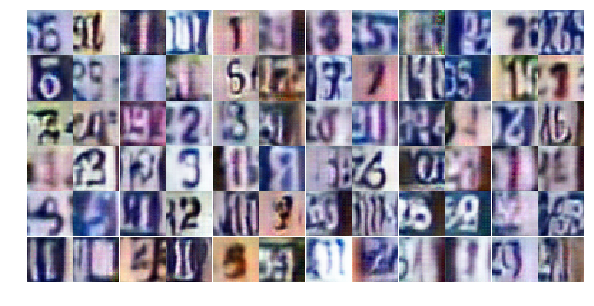

Epoch 10/24... Discriminator Loss: 1.3397... Generator Loss: 0.6587
Epoch 10/24... Discriminator Loss: 1.2888... Generator Loss: 0.6205
Epoch 10/24... Discriminator Loss: 1.0764... Generator Loss: 0.7274
Epoch 10/24... Discriminator Loss: 1.2871... Generator Loss: 0.9244
Epoch 10/24... Discriminator Loss: 1.1573... Generator Loss: 0.7146
Epoch 10/24... Discriminator Loss: 1.0780... Generator Loss: 0.8025
Epoch 10/24... Discriminator Loss: 1.0461... Generator Loss: 0.8044
Epoch 10/24... Discriminator Loss: 1.1418... Generator Loss: 0.6714
Epoch 10/24... Discriminator Loss: 1.1307... Generator Loss: 0.7047
Epoch 10/24... Discriminator Loss: 1.7172... Generator Loss: 1.4456


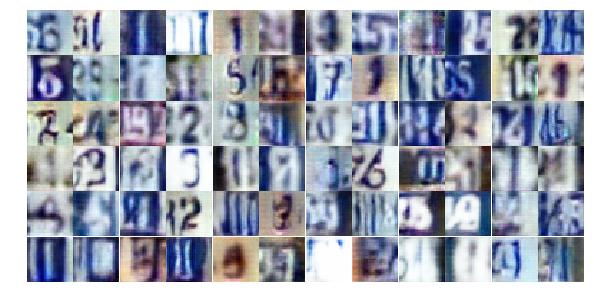

Epoch 10/24... Discriminator Loss: 1.2068... Generator Loss: 0.5441
Epoch 10/24... Discriminator Loss: 1.1114... Generator Loss: 0.8101
Epoch 10/24... Discriminator Loss: 1.2418... Generator Loss: 0.5829
Epoch 10/24... Discriminator Loss: 0.9092... Generator Loss: 0.9654
Epoch 10/24... Discriminator Loss: 0.9950... Generator Loss: 1.0750
Epoch 10/24... Discriminator Loss: 1.3553... Generator Loss: 0.5172
Epoch 10/24... Discriminator Loss: 1.1140... Generator Loss: 1.0193
Epoch 10/24... Discriminator Loss: 0.9558... Generator Loss: 1.1079
Epoch 10/24... Discriminator Loss: 0.9744... Generator Loss: 0.9600
Epoch 10/24... Discriminator Loss: 0.9829... Generator Loss: 0.9527


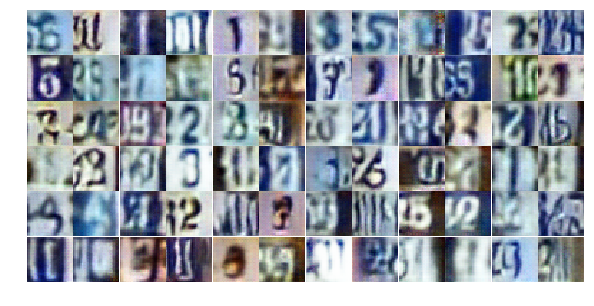

Epoch 10/24... Discriminator Loss: 1.4295... Generator Loss: 0.4549
Epoch 10/24... Discriminator Loss: 0.9719... Generator Loss: 0.7878
Epoch 10/24... Discriminator Loss: 0.9962... Generator Loss: 0.7297
Epoch 11/24... Discriminator Loss: 1.2381... Generator Loss: 1.1591
Epoch 11/24... Discriminator Loss: 1.0368... Generator Loss: 0.8202
Epoch 11/24... Discriminator Loss: 1.4070... Generator Loss: 0.4998
Epoch 11/24... Discriminator Loss: 1.4379... Generator Loss: 0.3984
Epoch 11/24... Discriminator Loss: 0.9331... Generator Loss: 1.3632
Epoch 11/24... Discriminator Loss: 1.3035... Generator Loss: 0.5221
Epoch 11/24... Discriminator Loss: 0.9010... Generator Loss: 0.9823


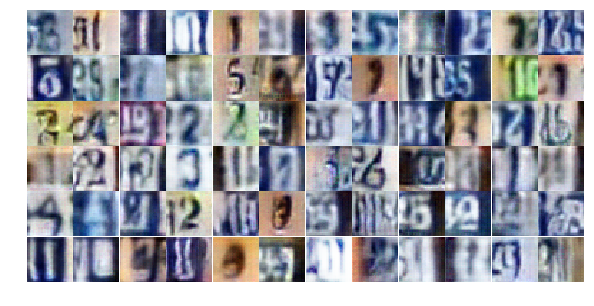

Epoch 11/24... Discriminator Loss: 1.0099... Generator Loss: 1.0662
Epoch 11/24... Discriminator Loss: 1.1785... Generator Loss: 0.6270
Epoch 11/24... Discriminator Loss: 0.8791... Generator Loss: 0.8459
Epoch 11/24... Discriminator Loss: 1.5240... Generator Loss: 0.3598
Epoch 11/24... Discriminator Loss: 1.3790... Generator Loss: 0.4384
Epoch 11/24... Discriminator Loss: 1.0439... Generator Loss: 0.7154
Epoch 11/24... Discriminator Loss: 1.0644... Generator Loss: 0.7551
Epoch 11/24... Discriminator Loss: 0.8008... Generator Loss: 1.1086
Epoch 11/24... Discriminator Loss: 1.1009... Generator Loss: 0.6657
Epoch 11/24... Discriminator Loss: 1.2921... Generator Loss: 0.4905


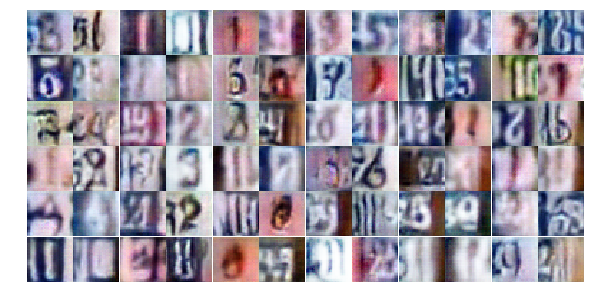

Epoch 11/24... Discriminator Loss: 1.4287... Generator Loss: 0.8554
Epoch 11/24... Discriminator Loss: 0.3419... Generator Loss: 1.4998
Epoch 11/24... Discriminator Loss: 1.5797... Generator Loss: 0.3336
Epoch 11/24... Discriminator Loss: 1.5343... Generator Loss: 1.1814
Epoch 11/24... Discriminator Loss: 0.6455... Generator Loss: 1.3933
Epoch 11/24... Discriminator Loss: 0.4275... Generator Loss: 3.1256
Epoch 11/24... Discriminator Loss: 1.0168... Generator Loss: 0.6095
Epoch 11/24... Discriminator Loss: 1.3759... Generator Loss: 1.7583
Epoch 11/24... Discriminator Loss: 1.2991... Generator Loss: 1.4596
Epoch 11/24... Discriminator Loss: 1.0862... Generator Loss: 0.8165


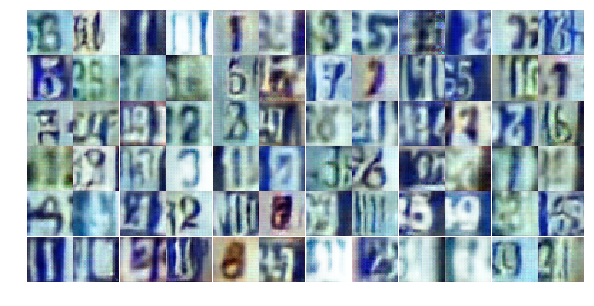

Epoch 11/24... Discriminator Loss: 1.3118... Generator Loss: 0.6521
Epoch 11/24... Discriminator Loss: 1.1414... Generator Loss: 0.7814
Epoch 11/24... Discriminator Loss: 1.1523... Generator Loss: 0.7092
Epoch 11/24... Discriminator Loss: 1.0207... Generator Loss: 0.7802
Epoch 11/24... Discriminator Loss: 1.2253... Generator Loss: 0.6526
Epoch 11/24... Discriminator Loss: 1.1494... Generator Loss: 0.7910
Epoch 11/24... Discriminator Loss: 1.3804... Generator Loss: 0.4900
Epoch 11/24... Discriminator Loss: 1.3166... Generator Loss: 0.4741
Epoch 11/24... Discriminator Loss: 1.2974... Generator Loss: 0.5281
Epoch 11/24... Discriminator Loss: 1.0718... Generator Loss: 1.1618


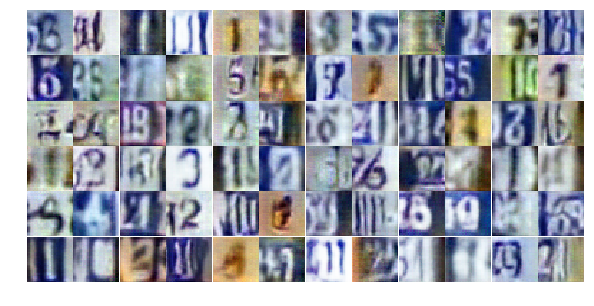

Epoch 11/24... Discriminator Loss: 0.9227... Generator Loss: 0.9021
Epoch 11/24... Discriminator Loss: 0.9408... Generator Loss: 0.8926
Epoch 11/24... Discriminator Loss: 1.2271... Generator Loss: 0.5869
Epoch 11/24... Discriminator Loss: 1.2201... Generator Loss: 0.9933
Epoch 11/24... Discriminator Loss: 0.9843... Generator Loss: 0.8315
Epoch 11/24... Discriminator Loss: 0.9991... Generator Loss: 0.7404
Epoch 11/24... Discriminator Loss: 0.6160... Generator Loss: 1.7391
Epoch 11/24... Discriminator Loss: 1.2348... Generator Loss: 0.5130
Epoch 11/24... Discriminator Loss: 1.3577... Generator Loss: 1.3680
Epoch 11/24... Discriminator Loss: 0.7197... Generator Loss: 1.0937


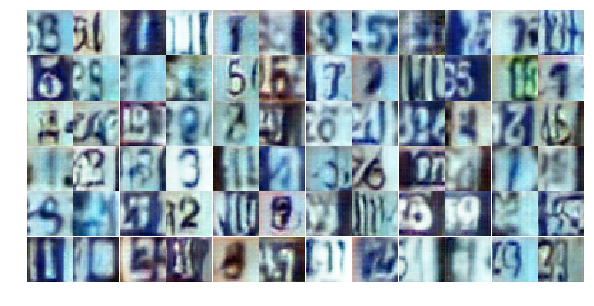

Epoch 11/24... Discriminator Loss: 1.1141... Generator Loss: 0.8220
Epoch 11/24... Discriminator Loss: 0.7666... Generator Loss: 0.9180
Epoch 11/24... Discriminator Loss: 0.5830... Generator Loss: 1.1223
Epoch 11/24... Discriminator Loss: 0.3133... Generator Loss: 2.0232
Epoch 11/24... Discriminator Loss: 1.4947... Generator Loss: 1.0553
Epoch 11/24... Discriminator Loss: 0.9902... Generator Loss: 1.2543
Epoch 11/24... Discriminator Loss: 1.2783... Generator Loss: 0.5679
Epoch 11/24... Discriminator Loss: 0.9243... Generator Loss: 1.1104
Epoch 11/24... Discriminator Loss: 1.1492... Generator Loss: 0.6455
Epoch 11/24... Discriminator Loss: 0.9261... Generator Loss: 0.8535


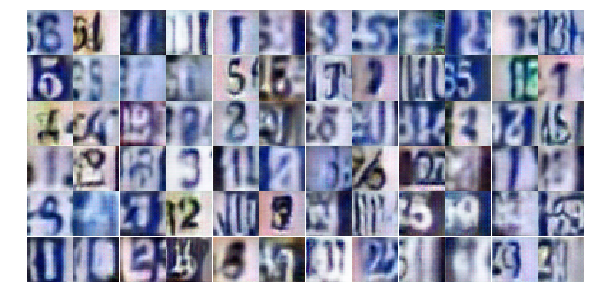

Epoch 12/24... Discriminator Loss: 1.0964... Generator Loss: 0.8166
Epoch 12/24... Discriminator Loss: 1.0128... Generator Loss: 0.7006
Epoch 12/24... Discriminator Loss: 1.1590... Generator Loss: 0.6119
Epoch 12/24... Discriminator Loss: 0.8808... Generator Loss: 1.0509
Epoch 12/24... Discriminator Loss: 1.0571... Generator Loss: 0.7520
Epoch 12/24... Discriminator Loss: 1.0205... Generator Loss: 0.6798
Epoch 12/24... Discriminator Loss: 1.0499... Generator Loss: 0.6580
Epoch 12/24... Discriminator Loss: 0.9118... Generator Loss: 0.8781
Epoch 12/24... Discriminator Loss: 0.9902... Generator Loss: 1.1561
Epoch 12/24... Discriminator Loss: 1.2666... Generator Loss: 0.5359


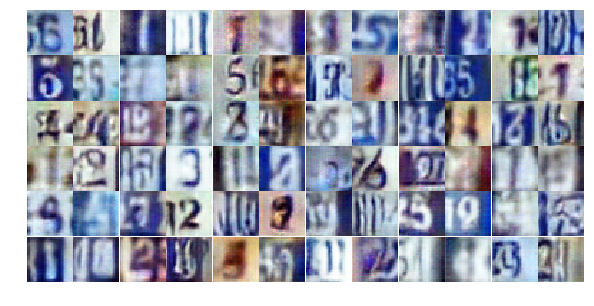

Epoch 12/24... Discriminator Loss: 0.9821... Generator Loss: 1.1422
Epoch 12/24... Discriminator Loss: 1.2952... Generator Loss: 0.5396
Epoch 12/24... Discriminator Loss: 0.8535... Generator Loss: 0.8365
Epoch 12/24... Discriminator Loss: 0.9878... Generator Loss: 0.9903
Epoch 12/24... Discriminator Loss: 0.7362... Generator Loss: 1.9430
Epoch 12/24... Discriminator Loss: 1.8690... Generator Loss: 0.3081
Epoch 12/24... Discriminator Loss: 1.8766... Generator Loss: 0.2163
Epoch 12/24... Discriminator Loss: 0.4166... Generator Loss: 1.6336
Epoch 12/24... Discriminator Loss: 1.0882... Generator Loss: 1.3793
Epoch 12/24... Discriminator Loss: 1.3816... Generator Loss: 0.5981


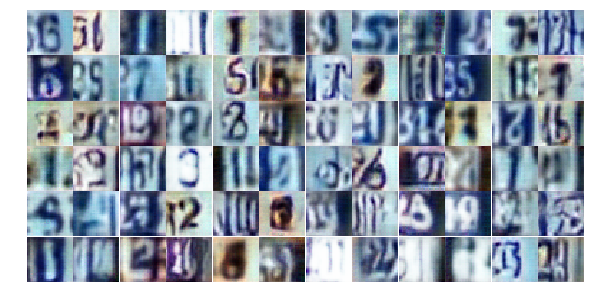

Epoch 12/24... Discriminator Loss: 0.8046... Generator Loss: 0.9882
Epoch 12/24... Discriminator Loss: 1.0532... Generator Loss: 0.7753
Epoch 12/24... Discriminator Loss: 1.1233... Generator Loss: 0.6188
Epoch 12/24... Discriminator Loss: 0.7631... Generator Loss: 1.2962
Epoch 12/24... Discriminator Loss: 0.8671... Generator Loss: 0.9006
Epoch 12/24... Discriminator Loss: 0.6380... Generator Loss: 1.2669
Epoch 12/24... Discriminator Loss: 0.9595... Generator Loss: 0.8383
Epoch 12/24... Discriminator Loss: 0.5217... Generator Loss: 1.8332
Epoch 12/24... Discriminator Loss: 0.6406... Generator Loss: 1.7414
Epoch 12/24... Discriminator Loss: 0.7472... Generator Loss: 0.7813


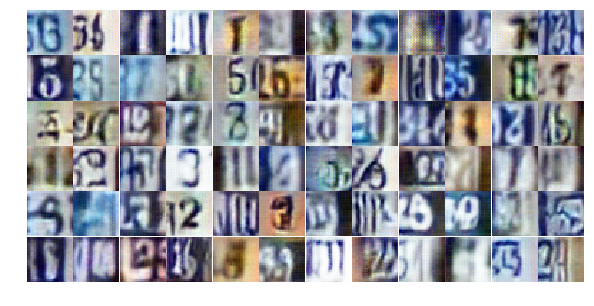

Epoch 12/24... Discriminator Loss: 1.5517... Generator Loss: 0.3730
Epoch 12/24... Discriminator Loss: 1.3391... Generator Loss: 0.4448
Epoch 12/24... Discriminator Loss: 1.0016... Generator Loss: 0.7753
Epoch 12/24... Discriminator Loss: 1.4193... Generator Loss: 0.4564
Epoch 12/24... Discriminator Loss: 0.2722... Generator Loss: 5.4033
Epoch 12/24... Discriminator Loss: 2.8633... Generator Loss: 3.1692
Epoch 12/24... Discriminator Loss: 1.2143... Generator Loss: 0.7507
Epoch 12/24... Discriminator Loss: 1.1610... Generator Loss: 0.8100
Epoch 12/24... Discriminator Loss: 1.0677... Generator Loss: 1.3660
Epoch 12/24... Discriminator Loss: 0.9943... Generator Loss: 0.9790


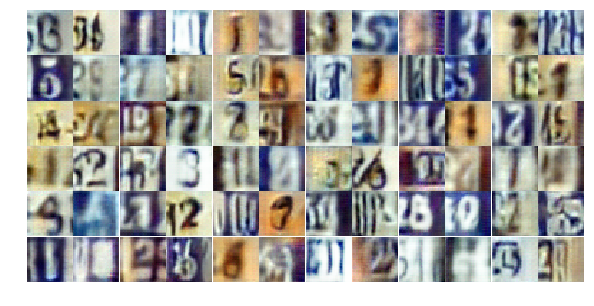

Epoch 12/24... Discriminator Loss: 0.7883... Generator Loss: 1.1014
Epoch 12/24... Discriminator Loss: 1.0350... Generator Loss: 0.8690
Epoch 12/24... Discriminator Loss: 0.8948... Generator Loss: 1.0013
Epoch 12/24... Discriminator Loss: 1.1793... Generator Loss: 0.8288
Epoch 12/24... Discriminator Loss: 1.0434... Generator Loss: 0.7539
Epoch 12/24... Discriminator Loss: 1.3552... Generator Loss: 0.6628
Epoch 12/24... Discriminator Loss: 1.0288... Generator Loss: 0.8612
Epoch 12/24... Discriminator Loss: 1.1595... Generator Loss: 0.6024
Epoch 12/24... Discriminator Loss: 0.8590... Generator Loss: 0.8894
Epoch 12/24... Discriminator Loss: 1.0094... Generator Loss: 0.7394


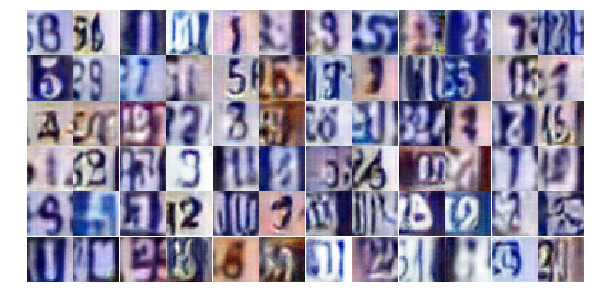

Epoch 12/24... Discriminator Loss: 1.1240... Generator Loss: 0.6999
Epoch 12/24... Discriminator Loss: 0.9298... Generator Loss: 0.8872
Epoch 12/24... Discriminator Loss: 0.9469... Generator Loss: 0.9233
Epoch 12/24... Discriminator Loss: 1.0374... Generator Loss: 0.9232
Epoch 12/24... Discriminator Loss: 1.1131... Generator Loss: 0.6705
Epoch 12/24... Discriminator Loss: 1.0211... Generator Loss: 0.9767
Epoch 12/24... Discriminator Loss: 1.2414... Generator Loss: 0.5430
Epoch 13/24... Discriminator Loss: 0.8571... Generator Loss: 1.0057
Epoch 13/24... Discriminator Loss: 0.9081... Generator Loss: 1.0701
Epoch 13/24... Discriminator Loss: 1.0631... Generator Loss: 0.8307


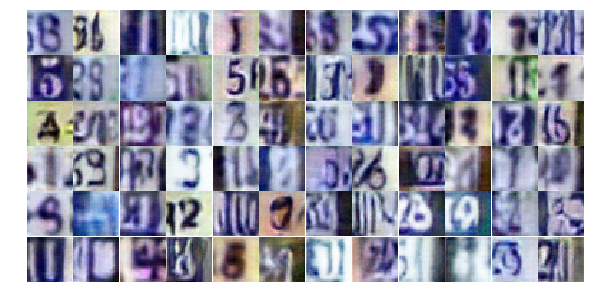

Epoch 13/24... Discriminator Loss: 1.0128... Generator Loss: 0.9346
Epoch 13/24... Discriminator Loss: 1.0269... Generator Loss: 1.0476
Epoch 13/24... Discriminator Loss: 1.5844... Generator Loss: 0.3432
Epoch 13/24... Discriminator Loss: 1.1680... Generator Loss: 0.5584
Epoch 13/24... Discriminator Loss: 0.9188... Generator Loss: 0.9607
Epoch 13/24... Discriminator Loss: 0.9080... Generator Loss: 1.1792
Epoch 13/24... Discriminator Loss: 0.9057... Generator Loss: 1.2941
Epoch 13/24... Discriminator Loss: 1.1987... Generator Loss: 0.5311
Epoch 13/24... Discriminator Loss: 1.0075... Generator Loss: 0.7863
Epoch 13/24... Discriminator Loss: 0.9655... Generator Loss: 0.9606


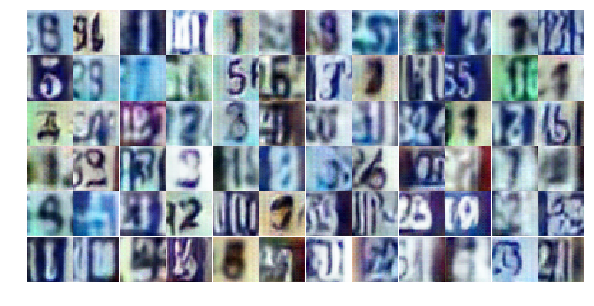

Epoch 13/24... Discriminator Loss: 1.0614... Generator Loss: 0.6838
Epoch 13/24... Discriminator Loss: 0.9315... Generator Loss: 1.0014
Epoch 13/24... Discriminator Loss: 1.4283... Generator Loss: 0.4296
Epoch 13/24... Discriminator Loss: 0.9503... Generator Loss: 0.9573
Epoch 13/24... Discriminator Loss: 1.1481... Generator Loss: 0.8029
Epoch 13/24... Discriminator Loss: 1.1276... Generator Loss: 0.7595
Epoch 13/24... Discriminator Loss: 0.9689... Generator Loss: 0.7384
Epoch 13/24... Discriminator Loss: 1.1393... Generator Loss: 0.7714
Epoch 13/24... Discriminator Loss: 0.9010... Generator Loss: 0.8897
Epoch 13/24... Discriminator Loss: 1.2265... Generator Loss: 0.5495


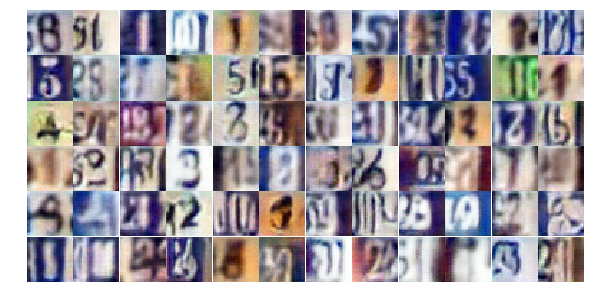

Epoch 13/24... Discriminator Loss: 1.1486... Generator Loss: 0.6065
Epoch 13/24... Discriminator Loss: 0.8328... Generator Loss: 1.1627
Epoch 13/24... Discriminator Loss: 0.9386... Generator Loss: 0.9484
Epoch 13/24... Discriminator Loss: 0.7500... Generator Loss: 1.5321
Epoch 13/24... Discriminator Loss: 1.5914... Generator Loss: 0.3273
Epoch 13/24... Discriminator Loss: 1.2478... Generator Loss: 0.5365
Epoch 13/24... Discriminator Loss: 1.1815... Generator Loss: 0.7662
Epoch 13/24... Discriminator Loss: 0.7492... Generator Loss: 1.2475
Epoch 13/24... Discriminator Loss: 1.1092... Generator Loss: 0.6166
Epoch 13/24... Discriminator Loss: 1.0908... Generator Loss: 1.7337


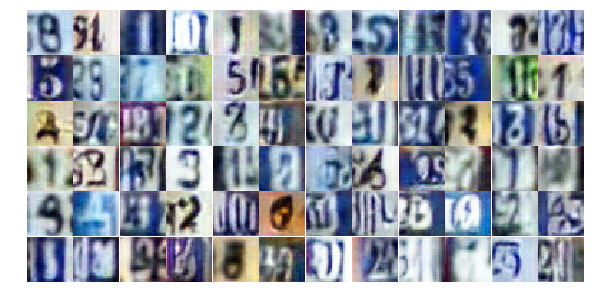

Epoch 13/24... Discriminator Loss: 0.9235... Generator Loss: 0.7674
Epoch 13/24... Discriminator Loss: 0.5918... Generator Loss: 1.1922
Epoch 13/24... Discriminator Loss: 1.6213... Generator Loss: 0.6153
Epoch 13/24... Discriminator Loss: 1.1922... Generator Loss: 0.6954
Epoch 13/24... Discriminator Loss: 0.7915... Generator Loss: 1.0527
Epoch 13/24... Discriminator Loss: 0.9837... Generator Loss: 0.7515
Epoch 13/24... Discriminator Loss: 1.0924... Generator Loss: 0.6709
Epoch 13/24... Discriminator Loss: 1.0249... Generator Loss: 0.8815
Epoch 13/24... Discriminator Loss: 0.9413... Generator Loss: 0.8439
Epoch 13/24... Discriminator Loss: 1.0907... Generator Loss: 0.6087


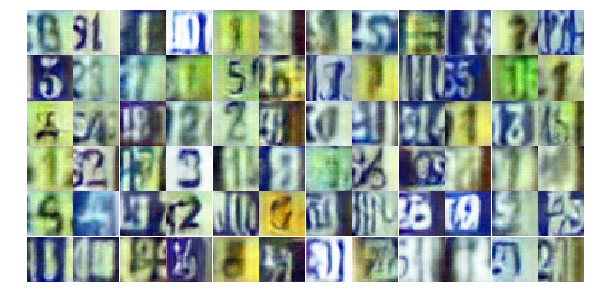

Epoch 13/24... Discriminator Loss: 0.8926... Generator Loss: 1.1092
Epoch 13/24... Discriminator Loss: 1.0737... Generator Loss: 0.7386
Epoch 13/24... Discriminator Loss: 1.0146... Generator Loss: 0.7568
Epoch 13/24... Discriminator Loss: 0.8278... Generator Loss: 1.7560
Epoch 13/24... Discriminator Loss: 0.8171... Generator Loss: 1.1542
Epoch 13/24... Discriminator Loss: 0.9612... Generator Loss: 0.6621
Epoch 13/24... Discriminator Loss: 1.5192... Generator Loss: 0.3930
Epoch 13/24... Discriminator Loss: 1.4091... Generator Loss: 0.4770
Epoch 13/24... Discriminator Loss: 1.3171... Generator Loss: 0.4637
Epoch 13/24... Discriminator Loss: 1.0064... Generator Loss: 1.4175


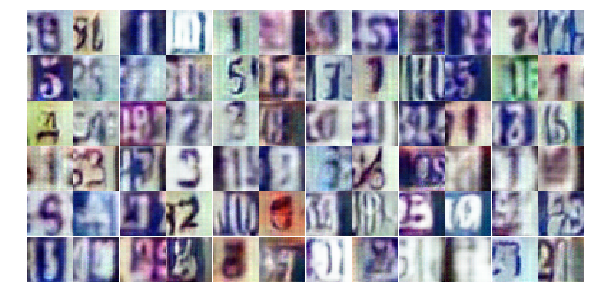

Epoch 13/24... Discriminator Loss: 0.3648... Generator Loss: 1.9546
Epoch 13/24... Discriminator Loss: 1.3821... Generator Loss: 0.6115
Epoch 13/24... Discriminator Loss: 1.3387... Generator Loss: 3.9682
Epoch 13/24... Discriminator Loss: 0.9331... Generator Loss: 0.7367
Epoch 14/24... Discriminator Loss: 1.4316... Generator Loss: 0.4744
Epoch 14/24... Discriminator Loss: 1.3419... Generator Loss: 0.6011
Epoch 14/24... Discriminator Loss: 1.1885... Generator Loss: 0.6141
Epoch 14/24... Discriminator Loss: 1.2259... Generator Loss: 1.7625
Epoch 14/24... Discriminator Loss: 1.0213... Generator Loss: 0.8950
Epoch 14/24... Discriminator Loss: 1.1075... Generator Loss: 0.6757


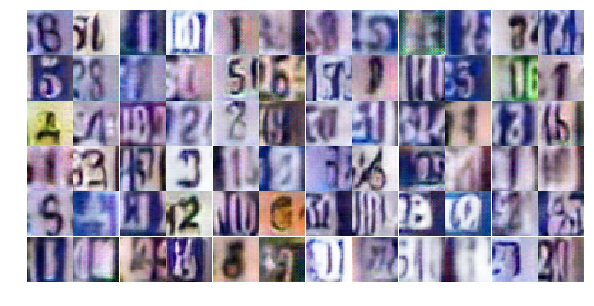

Epoch 14/24... Discriminator Loss: 1.1136... Generator Loss: 1.0244
Epoch 14/24... Discriminator Loss: 1.1396... Generator Loss: 0.5569
Epoch 14/24... Discriminator Loss: 0.9858... Generator Loss: 0.7814
Epoch 14/24... Discriminator Loss: 1.0716... Generator Loss: 0.8104
Epoch 14/24... Discriminator Loss: 1.0192... Generator Loss: 0.7261
Epoch 14/24... Discriminator Loss: 0.7682... Generator Loss: 0.9450
Epoch 14/24... Discriminator Loss: 0.7891... Generator Loss: 1.3822
Epoch 14/24... Discriminator Loss: 1.5185... Generator Loss: 0.3885
Epoch 14/24... Discriminator Loss: 1.4508... Generator Loss: 0.3758
Epoch 14/24... Discriminator Loss: 0.8270... Generator Loss: 0.9127


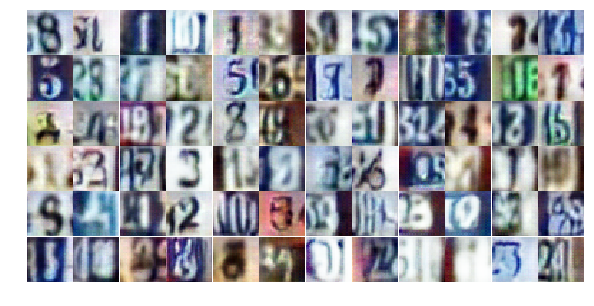

Epoch 14/24... Discriminator Loss: 1.4635... Generator Loss: 0.3900
Epoch 14/24... Discriminator Loss: 0.8634... Generator Loss: 1.3481
Epoch 14/24... Discriminator Loss: 1.0780... Generator Loss: 0.6130
Epoch 14/24... Discriminator Loss: 0.5138... Generator Loss: 1.1833
Epoch 14/24... Discriminator Loss: 0.4881... Generator Loss: 2.5378
Epoch 14/24... Discriminator Loss: 2.1678... Generator Loss: 0.1886
Epoch 14/24... Discriminator Loss: 1.1318... Generator Loss: 0.6603
Epoch 14/24... Discriminator Loss: 0.1682... Generator Loss: 2.9116
Epoch 14/24... Discriminator Loss: 0.8709... Generator Loss: 0.8083
Epoch 14/24... Discriminator Loss: 1.3305... Generator Loss: 0.4275


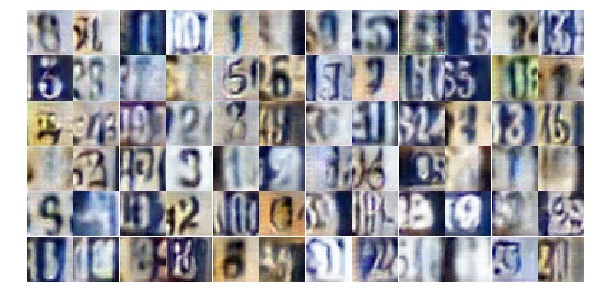

Epoch 14/24... Discriminator Loss: 1.1520... Generator Loss: 0.6085
Epoch 14/24... Discriminator Loss: 0.9057... Generator Loss: 1.3705
Epoch 14/24... Discriminator Loss: 1.0386... Generator Loss: 0.8086
Epoch 14/24... Discriminator Loss: 0.9736... Generator Loss: 0.8063
Epoch 14/24... Discriminator Loss: 1.0643... Generator Loss: 0.6873
Epoch 14/24... Discriminator Loss: 1.3690... Generator Loss: 0.5171
Epoch 14/24... Discriminator Loss: 0.9458... Generator Loss: 1.1748
Epoch 14/24... Discriminator Loss: 0.8165... Generator Loss: 1.1731
Epoch 14/24... Discriminator Loss: 0.7788... Generator Loss: 1.0001
Epoch 14/24... Discriminator Loss: 0.7585... Generator Loss: 0.9275


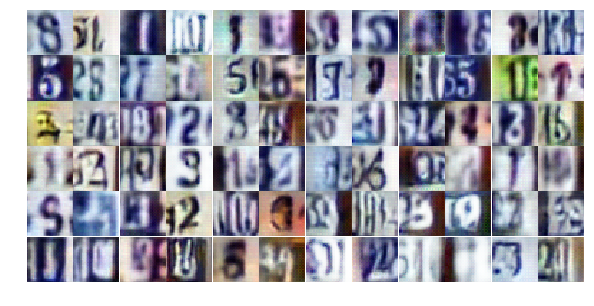

Epoch 14/24... Discriminator Loss: 1.3556... Generator Loss: 0.4571
Epoch 14/24... Discriminator Loss: 1.1997... Generator Loss: 0.5723
Epoch 14/24... Discriminator Loss: 0.9725... Generator Loss: 0.7245
Epoch 14/24... Discriminator Loss: 0.6063... Generator Loss: 1.1297
Epoch 14/24... Discriminator Loss: 0.6000... Generator Loss: 2.0416
Epoch 14/24... Discriminator Loss: 0.9496... Generator Loss: 0.8206
Epoch 14/24... Discriminator Loss: 1.2206... Generator Loss: 0.6977
Epoch 14/24... Discriminator Loss: 1.0471... Generator Loss: 0.8968
Epoch 14/24... Discriminator Loss: 1.1689... Generator Loss: 0.6915
Epoch 14/24... Discriminator Loss: 1.1669... Generator Loss: 0.6927


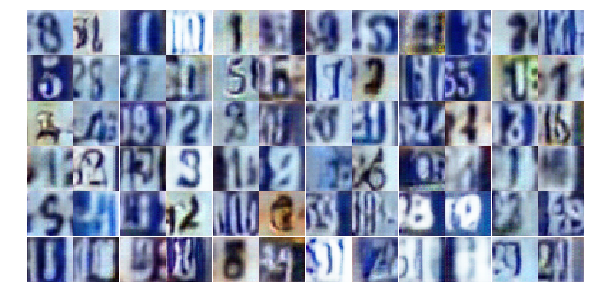

Epoch 14/24... Discriminator Loss: 1.2586... Generator Loss: 0.6597
Epoch 14/24... Discriminator Loss: 1.3380... Generator Loss: 0.4685
Epoch 14/24... Discriminator Loss: 1.2450... Generator Loss: 0.5452
Epoch 14/24... Discriminator Loss: 0.8473... Generator Loss: 0.7849
Epoch 14/24... Discriminator Loss: 0.3772... Generator Loss: 2.2969
Epoch 14/24... Discriminator Loss: 1.6167... Generator Loss: 0.3431
Epoch 14/24... Discriminator Loss: 1.4398... Generator Loss: 0.5224
Epoch 14/24... Discriminator Loss: 0.8444... Generator Loss: 0.9844
Epoch 14/24... Discriminator Loss: 1.2389... Generator Loss: 0.5796
Epoch 14/24... Discriminator Loss: 1.1503... Generator Loss: 0.5676


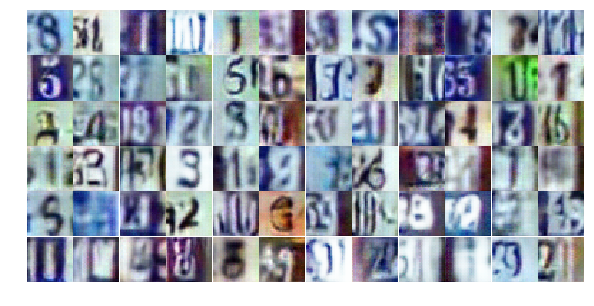

Epoch 14/24... Discriminator Loss: 0.8236... Generator Loss: 0.8721
Epoch 14/24... Discriminator Loss: 0.4304... Generator Loss: 1.8224
Epoch 15/24... Discriminator Loss: 0.2289... Generator Loss: 3.8232
Epoch 15/24... Discriminator Loss: 1.0978... Generator Loss: 1.3539
Epoch 15/24... Discriminator Loss: 1.8467... Generator Loss: 0.2525
Epoch 15/24... Discriminator Loss: 0.9446... Generator Loss: 0.6920
Epoch 15/24... Discriminator Loss: 1.0001... Generator Loss: 0.7866
Epoch 15/24... Discriminator Loss: 0.3482... Generator Loss: 1.6499
Epoch 15/24... Discriminator Loss: 1.2371... Generator Loss: 0.7860
Epoch 15/24... Discriminator Loss: 1.2121... Generator Loss: 0.6129


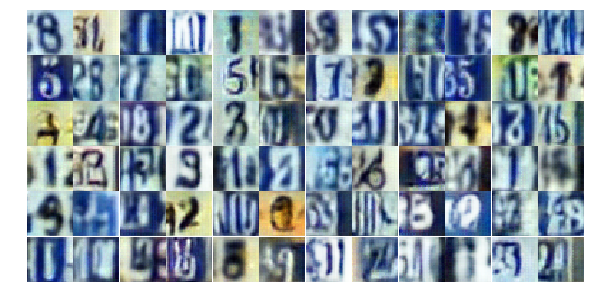

Epoch 15/24... Discriminator Loss: 0.6434... Generator Loss: 0.9523
Epoch 15/24... Discriminator Loss: 0.3188... Generator Loss: 1.6160
Epoch 15/24... Discriminator Loss: 0.8650... Generator Loss: 1.4800
Epoch 15/24... Discriminator Loss: 1.2773... Generator Loss: 0.4961
Epoch 15/24... Discriminator Loss: 1.0162... Generator Loss: 0.6458
Epoch 15/24... Discriminator Loss: 1.3419... Generator Loss: 0.3986
Epoch 15/24... Discriminator Loss: 0.5282... Generator Loss: 1.2394
Epoch 15/24... Discriminator Loss: 0.6569... Generator Loss: 3.5288
Epoch 15/24... Discriminator Loss: 0.7944... Generator Loss: 2.5178
Epoch 15/24... Discriminator Loss: 0.0869... Generator Loss: 3.1641


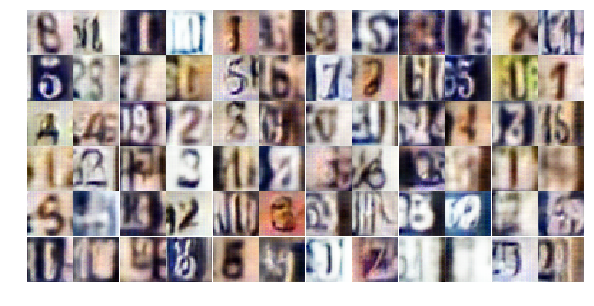

Epoch 15/24... Discriminator Loss: 3.6042... Generator Loss: 4.8095
Epoch 15/24... Discriminator Loss: 0.9161... Generator Loss: 0.9307
Epoch 15/24... Discriminator Loss: 1.6604... Generator Loss: 0.3737
Epoch 15/24... Discriminator Loss: 0.8237... Generator Loss: 3.4671
Epoch 15/24... Discriminator Loss: 0.9243... Generator Loss: 0.7507
Epoch 15/24... Discriminator Loss: 1.3832... Generator Loss: 0.4270
Epoch 15/24... Discriminator Loss: 0.5945... Generator Loss: 1.0749
Epoch 15/24... Discriminator Loss: 0.9715... Generator Loss: 0.7971
Epoch 15/24... Discriminator Loss: 0.4958... Generator Loss: 1.2458
Epoch 15/24... Discriminator Loss: 0.3562... Generator Loss: 2.1148


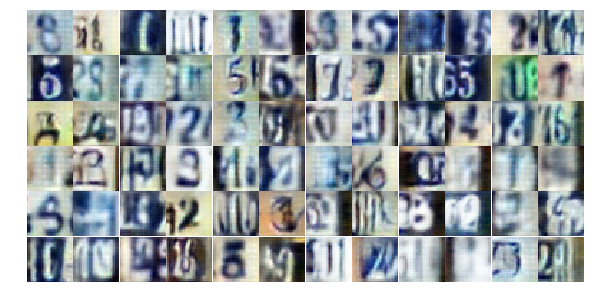

Epoch 15/24... Discriminator Loss: 1.7106... Generator Loss: 0.4323
Epoch 15/24... Discriminator Loss: 1.0872... Generator Loss: 0.7770
Epoch 15/24... Discriminator Loss: 0.8365... Generator Loss: 1.0874
Epoch 15/24... Discriminator Loss: 1.1218... Generator Loss: 0.8621
Epoch 15/24... Discriminator Loss: 0.8933... Generator Loss: 0.8615
Epoch 15/24... Discriminator Loss: 0.8834... Generator Loss: 1.1061
Epoch 15/24... Discriminator Loss: 0.8516... Generator Loss: 1.2745
Epoch 15/24... Discriminator Loss: 0.9595... Generator Loss: 0.9388
Epoch 15/24... Discriminator Loss: 0.9864... Generator Loss: 0.9523
Epoch 15/24... Discriminator Loss: 0.9372... Generator Loss: 0.8911


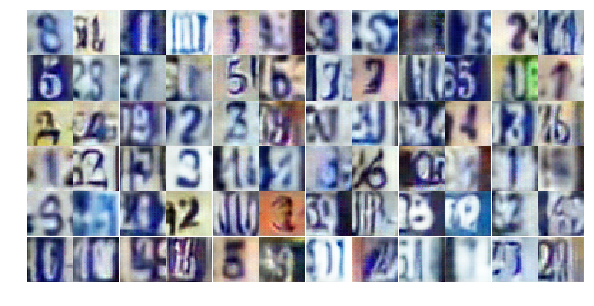

Epoch 15/24... Discriminator Loss: 0.9636... Generator Loss: 0.7738
Epoch 15/24... Discriminator Loss: 1.4658... Generator Loss: 0.4494
Epoch 15/24... Discriminator Loss: 0.9792... Generator Loss: 0.8685
Epoch 15/24... Discriminator Loss: 1.1037... Generator Loss: 0.6724
Epoch 15/24... Discriminator Loss: 1.0329... Generator Loss: 0.7021
Epoch 15/24... Discriminator Loss: 1.2688... Generator Loss: 0.4864
Epoch 15/24... Discriminator Loss: 0.6329... Generator Loss: 1.1858
Epoch 15/24... Discriminator Loss: 0.9715... Generator Loss: 0.9601
Epoch 15/24... Discriminator Loss: 0.8817... Generator Loss: 1.4001
Epoch 15/24... Discriminator Loss: 1.0642... Generator Loss: 0.9451


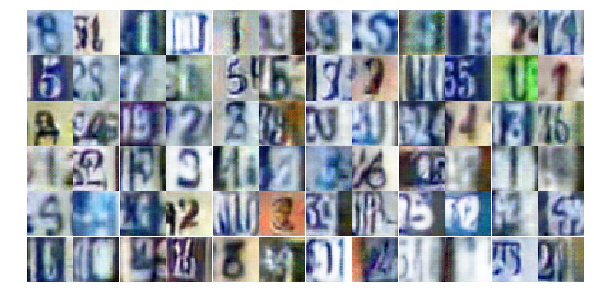

Epoch 15/24... Discriminator Loss: 1.3199... Generator Loss: 0.4842
Epoch 15/24... Discriminator Loss: 1.2471... Generator Loss: 0.5769
Epoch 15/24... Discriminator Loss: 0.9068... Generator Loss: 0.8716
Epoch 15/24... Discriminator Loss: 1.1698... Generator Loss: 0.7441
Epoch 15/24... Discriminator Loss: 0.7720... Generator Loss: 1.0583
Epoch 15/24... Discriminator Loss: 0.9436... Generator Loss: 0.9940
Epoch 15/24... Discriminator Loss: 1.1958... Generator Loss: 0.5752
Epoch 15/24... Discriminator Loss: 1.0438... Generator Loss: 0.8537
Epoch 15/24... Discriminator Loss: 1.5435... Generator Loss: 0.3890
Epoch 16/24... Discriminator Loss: 1.4398... Generator Loss: 0.4417


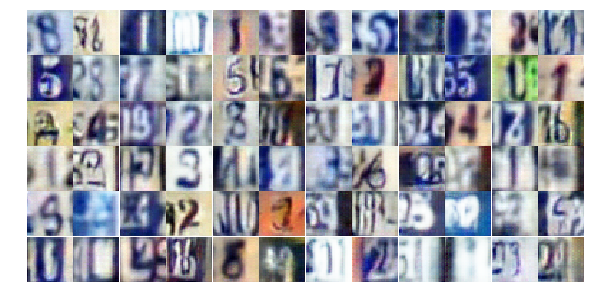

Epoch 16/24... Discriminator Loss: 1.1204... Generator Loss: 0.6016
Epoch 16/24... Discriminator Loss: 1.5710... Generator Loss: 0.3522
Epoch 16/24... Discriminator Loss: 1.0711... Generator Loss: 0.7892
Epoch 16/24... Discriminator Loss: 1.1974... Generator Loss: 0.7224
Epoch 16/24... Discriminator Loss: 1.2169... Generator Loss: 0.8513
Epoch 16/24... Discriminator Loss: 0.9733... Generator Loss: 1.8917
Epoch 16/24... Discriminator Loss: 1.3884... Generator Loss: 0.4413
Epoch 16/24... Discriminator Loss: 1.0728... Generator Loss: 0.6264
Epoch 16/24... Discriminator Loss: 0.9975... Generator Loss: 0.9041
Epoch 16/24... Discriminator Loss: 1.0926... Generator Loss: 1.0462


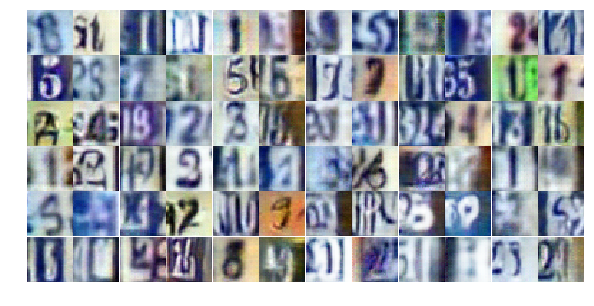

Epoch 16/24... Discriminator Loss: 1.3571... Generator Loss: 0.4844
Epoch 16/24... Discriminator Loss: 0.9600... Generator Loss: 0.8220
Epoch 16/24... Discriminator Loss: 0.9941... Generator Loss: 1.1046
Epoch 16/24... Discriminator Loss: 1.8681... Generator Loss: 0.2485
Epoch 16/24... Discriminator Loss: 0.8282... Generator Loss: 1.5550
Epoch 16/24... Discriminator Loss: 1.1173... Generator Loss: 0.7847
Epoch 16/24... Discriminator Loss: 1.2561... Generator Loss: 0.5671
Epoch 16/24... Discriminator Loss: 0.7872... Generator Loss: 1.4628
Epoch 16/24... Discriminator Loss: 0.7849... Generator Loss: 1.1081
Epoch 16/24... Discriminator Loss: 0.8234... Generator Loss: 1.1958


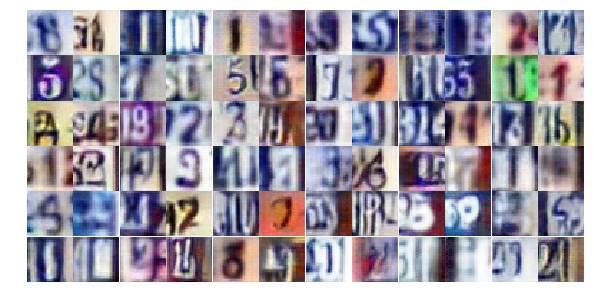

Epoch 16/24... Discriminator Loss: 1.0913... Generator Loss: 0.7888
Epoch 16/24... Discriminator Loss: 1.1197... Generator Loss: 1.0716
Epoch 16/24... Discriminator Loss: 0.9735... Generator Loss: 0.9001
Epoch 16/24... Discriminator Loss: 1.4351... Generator Loss: 0.3998
Epoch 16/24... Discriminator Loss: 1.2202... Generator Loss: 0.7574
Epoch 16/24... Discriminator Loss: 1.0837... Generator Loss: 0.6605
Epoch 16/24... Discriminator Loss: 0.8805... Generator Loss: 0.9852
Epoch 16/24... Discriminator Loss: 0.8913... Generator Loss: 0.8670
Epoch 16/24... Discriminator Loss: 1.0555... Generator Loss: 0.7973
Epoch 16/24... Discriminator Loss: 0.9051... Generator Loss: 0.9701


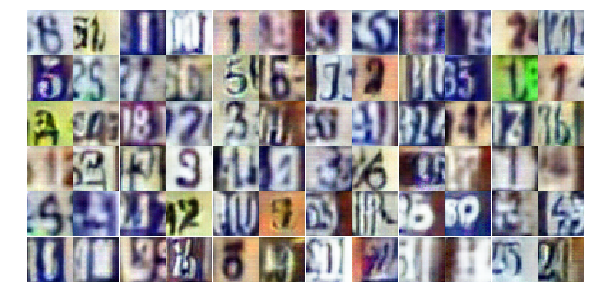

Epoch 16/24... Discriminator Loss: 1.0344... Generator Loss: 0.6963
Epoch 16/24... Discriminator Loss: 0.9198... Generator Loss: 0.7567
Epoch 16/24... Discriminator Loss: 0.8877... Generator Loss: 1.3980
Epoch 16/24... Discriminator Loss: 1.0482... Generator Loss: 0.7267
Epoch 16/24... Discriminator Loss: 1.3163... Generator Loss: 0.5811
Epoch 16/24... Discriminator Loss: 0.8672... Generator Loss: 0.9370
Epoch 16/24... Discriminator Loss: 0.7948... Generator Loss: 1.4122
Epoch 16/24... Discriminator Loss: 1.4449... Generator Loss: 0.4039
Epoch 16/24... Discriminator Loss: 0.9386... Generator Loss: 0.8021
Epoch 16/24... Discriminator Loss: 0.6607... Generator Loss: 1.2551


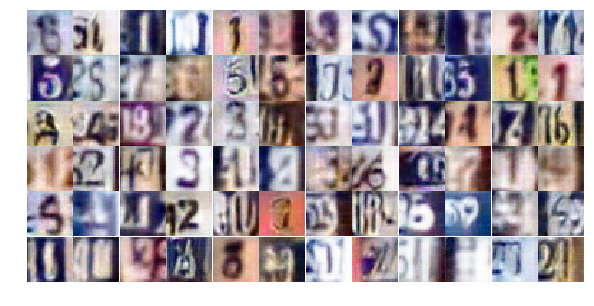

Epoch 16/24... Discriminator Loss: 0.6916... Generator Loss: 1.3352
Epoch 16/24... Discriminator Loss: 1.0512... Generator Loss: 0.7870
Epoch 16/24... Discriminator Loss: 1.2109... Generator Loss: 0.5240
Epoch 16/24... Discriminator Loss: 1.6872... Generator Loss: 0.8561
Epoch 16/24... Discriminator Loss: 0.8841... Generator Loss: 0.8956
Epoch 16/24... Discriminator Loss: 0.6366... Generator Loss: 1.5995
Epoch 16/24... Discriminator Loss: 0.2747... Generator Loss: 1.8531
Epoch 16/24... Discriminator Loss: 0.7469... Generator Loss: 0.8411
Epoch 16/24... Discriminator Loss: 0.2736... Generator Loss: 2.6516
Epoch 16/24... Discriminator Loss: 1.7765... Generator Loss: 0.2834


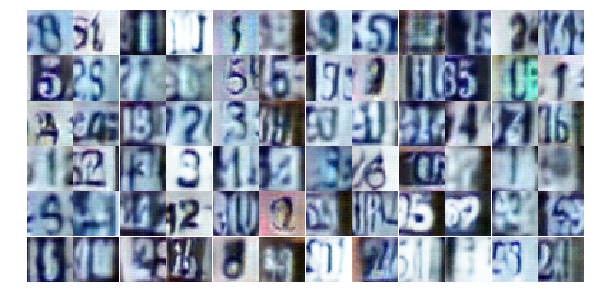

Epoch 16/24... Discriminator Loss: 0.7290... Generator Loss: 2.3997
Epoch 16/24... Discriminator Loss: 1.1224... Generator Loss: 1.8343
Epoch 16/24... Discriminator Loss: 1.4539... Generator Loss: 0.5411
Epoch 16/24... Discriminator Loss: 0.7496... Generator Loss: 1.7328
Epoch 16/24... Discriminator Loss: 0.9320... Generator Loss: 1.4515
Epoch 16/24... Discriminator Loss: 1.0167... Generator Loss: 0.6828
Epoch 17/24... Discriminator Loss: 0.9607... Generator Loss: 1.8885
Epoch 17/24... Discriminator Loss: 1.0323... Generator Loss: 0.8741
Epoch 17/24... Discriminator Loss: 1.0687... Generator Loss: 0.6926
Epoch 17/24... Discriminator Loss: 1.1707... Generator Loss: 0.6466


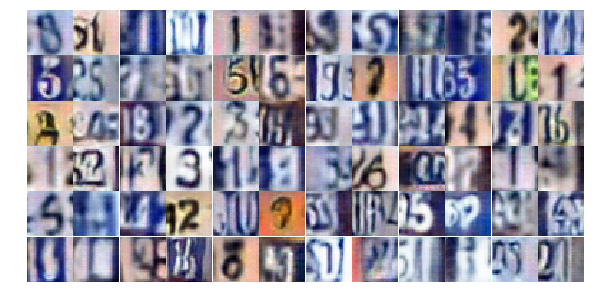

Epoch 17/24... Discriminator Loss: 0.8207... Generator Loss: 1.1362
Epoch 17/24... Discriminator Loss: 0.8860... Generator Loss: 0.8316
Epoch 17/24... Discriminator Loss: 0.9229... Generator Loss: 0.9715
Epoch 17/24... Discriminator Loss: 0.9984... Generator Loss: 0.7836
Epoch 17/24... Discriminator Loss: 1.2715... Generator Loss: 0.5084
Epoch 17/24... Discriminator Loss: 1.4244... Generator Loss: 0.4489
Epoch 17/24... Discriminator Loss: 1.0398... Generator Loss: 1.0823
Epoch 17/24... Discriminator Loss: 0.8510... Generator Loss: 1.1642
Epoch 17/24... Discriminator Loss: 0.8793... Generator Loss: 0.8205
Epoch 17/24... Discriminator Loss: 0.9754... Generator Loss: 0.9128


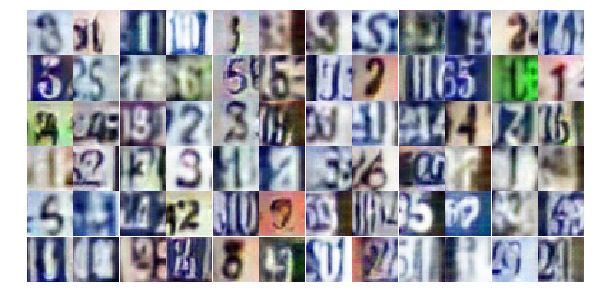

Epoch 17/24... Discriminator Loss: 0.8627... Generator Loss: 1.2521
Epoch 17/24... Discriminator Loss: 1.0216... Generator Loss: 0.7251
Epoch 17/24... Discriminator Loss: 0.9210... Generator Loss: 0.7899
Epoch 17/24... Discriminator Loss: 1.1423... Generator Loss: 0.6734
Epoch 17/24... Discriminator Loss: 0.7890... Generator Loss: 1.0316
Epoch 17/24... Discriminator Loss: 1.1891... Generator Loss: 0.5527
Epoch 17/24... Discriminator Loss: 0.8524... Generator Loss: 1.2384
Epoch 17/24... Discriminator Loss: 1.1683... Generator Loss: 0.5932
Epoch 17/24... Discriminator Loss: 0.8424... Generator Loss: 1.0022
Epoch 17/24... Discriminator Loss: 0.6713... Generator Loss: 1.0828


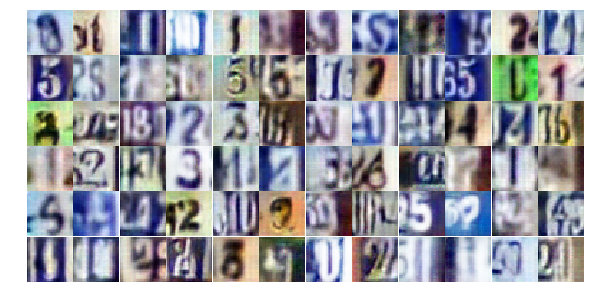

Epoch 17/24... Discriminator Loss: 1.1547... Generator Loss: 0.6071
Epoch 17/24... Discriminator Loss: 0.7237... Generator Loss: 1.0649
Epoch 17/24... Discriminator Loss: 1.0405... Generator Loss: 0.7451
Epoch 17/24... Discriminator Loss: 1.5749... Generator Loss: 0.4333
Epoch 17/24... Discriminator Loss: 2.1936... Generator Loss: 0.1821
Epoch 17/24... Discriminator Loss: 1.0379... Generator Loss: 0.7847
Epoch 17/24... Discriminator Loss: 1.0276... Generator Loss: 0.6801
Epoch 17/24... Discriminator Loss: 1.0167... Generator Loss: 0.7238
Epoch 17/24... Discriminator Loss: 1.1110... Generator Loss: 0.7364
Epoch 17/24... Discriminator Loss: 0.8921... Generator Loss: 0.8341


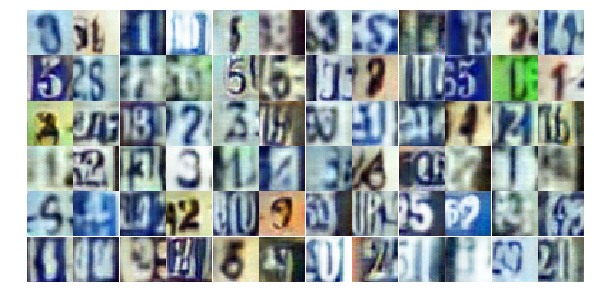

Epoch 17/24... Discriminator Loss: 0.8751... Generator Loss: 0.9850
Epoch 17/24... Discriminator Loss: 1.3043... Generator Loss: 0.7109
Epoch 17/24... Discriminator Loss: 0.7985... Generator Loss: 1.3258
Epoch 17/24... Discriminator Loss: 1.3126... Generator Loss: 0.5078
Epoch 17/24... Discriminator Loss: 0.6873... Generator Loss: 1.5171
Epoch 17/24... Discriminator Loss: 0.6587... Generator Loss: 1.2249
Epoch 17/24... Discriminator Loss: 1.1083... Generator Loss: 0.7363
Epoch 17/24... Discriminator Loss: 0.6573... Generator Loss: 1.5347
Epoch 17/24... Discriminator Loss: 0.4927... Generator Loss: 1.5772
Epoch 17/24... Discriminator Loss: 1.2232... Generator Loss: 0.5167


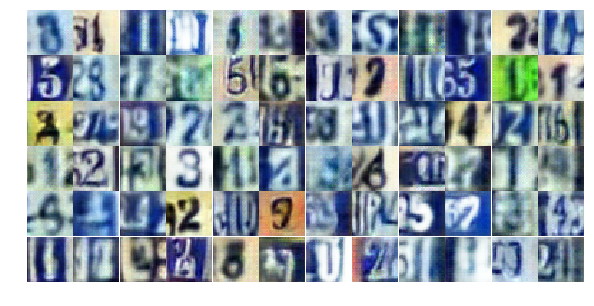

Epoch 17/24... Discriminator Loss: 1.4761... Generator Loss: 0.3765
Epoch 17/24... Discriminator Loss: 0.5211... Generator Loss: 1.3812
Epoch 17/24... Discriminator Loss: 1.2675... Generator Loss: 0.6301
Epoch 17/24... Discriminator Loss: 0.5063... Generator Loss: 2.0055
Epoch 17/24... Discriminator Loss: 1.1976... Generator Loss: 0.6007
Epoch 17/24... Discriminator Loss: 1.9817... Generator Loss: 0.9510
Epoch 17/24... Discriminator Loss: 1.6330... Generator Loss: 0.4086
Epoch 17/24... Discriminator Loss: 1.1934... Generator Loss: 0.6894
Epoch 17/24... Discriminator Loss: 0.8504... Generator Loss: 1.3333
Epoch 17/24... Discriminator Loss: 0.5631... Generator Loss: 1.1812


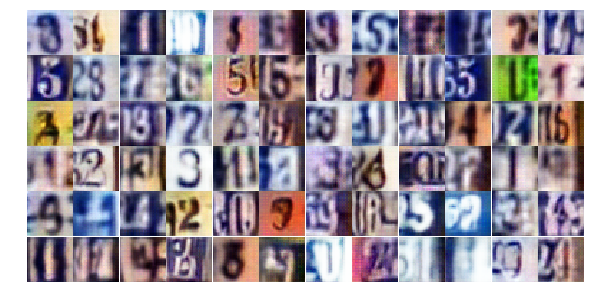

Epoch 17/24... Discriminator Loss: 1.0190... Generator Loss: 1.0663
Epoch 17/24... Discriminator Loss: 1.8218... Generator Loss: 0.3555
Epoch 17/24... Discriminator Loss: 1.1580... Generator Loss: 0.7403
Epoch 17/24... Discriminator Loss: 0.4002... Generator Loss: 1.7398
Epoch 18/24... Discriminator Loss: 0.8932... Generator Loss: 1.1986
Epoch 18/24... Discriminator Loss: 0.8554... Generator Loss: 0.7929
Epoch 18/24... Discriminator Loss: 0.0372... Generator Loss: 4.2744
Epoch 18/24... Discriminator Loss: 0.9999... Generator Loss: 1.3119
Epoch 18/24... Discriminator Loss: 1.0239... Generator Loss: 0.8085
Epoch 18/24... Discriminator Loss: 1.4830... Generator Loss: 0.4337


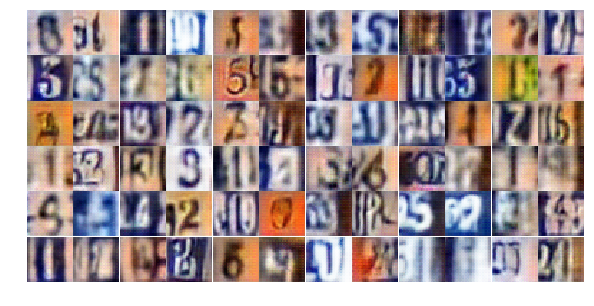

Epoch 18/24... Discriminator Loss: 0.6366... Generator Loss: 1.4015
Epoch 18/24... Discriminator Loss: 1.4139... Generator Loss: 0.4270
Epoch 18/24... Discriminator Loss: 0.9823... Generator Loss: 0.8347
Epoch 18/24... Discriminator Loss: 0.7851... Generator Loss: 1.1979
Epoch 18/24... Discriminator Loss: 0.8848... Generator Loss: 1.0650
Epoch 18/24... Discriminator Loss: 1.3243... Generator Loss: 0.4573
Epoch 18/24... Discriminator Loss: 0.8120... Generator Loss: 0.9748
Epoch 18/24... Discriminator Loss: 0.9949... Generator Loss: 0.7358
Epoch 18/24... Discriminator Loss: 0.8135... Generator Loss: 1.0190
Epoch 18/24... Discriminator Loss: 0.7360... Generator Loss: 1.1581


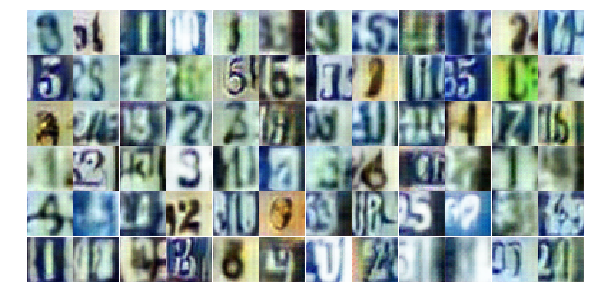

Epoch 18/24... Discriminator Loss: 0.9011... Generator Loss: 0.9568
Epoch 18/24... Discriminator Loss: 1.1570... Generator Loss: 0.6347
Epoch 18/24... Discriminator Loss: 0.9242... Generator Loss: 0.8526
Epoch 18/24... Discriminator Loss: 0.8211... Generator Loss: 1.1588
Epoch 18/24... Discriminator Loss: 1.4240... Generator Loss: 0.4714
Epoch 18/24... Discriminator Loss: 0.8238... Generator Loss: 0.8690
Epoch 18/24... Discriminator Loss: 1.0744... Generator Loss: 0.7318
Epoch 18/24... Discriminator Loss: 0.9852... Generator Loss: 0.7469
Epoch 18/24... Discriminator Loss: 1.2794... Generator Loss: 0.5361
Epoch 18/24... Discriminator Loss: 0.9978... Generator Loss: 0.6778


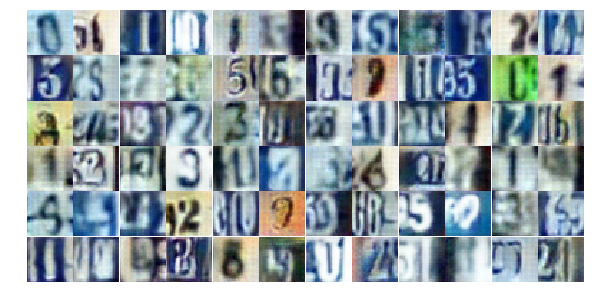

Epoch 18/24... Discriminator Loss: 0.5214... Generator Loss: 1.4609
Epoch 18/24... Discriminator Loss: 1.0028... Generator Loss: 1.5898
Epoch 18/24... Discriminator Loss: 1.1976... Generator Loss: 0.6005
Epoch 18/24... Discriminator Loss: 1.0917... Generator Loss: 0.6376
Epoch 18/24... Discriminator Loss: 1.2046... Generator Loss: 0.5610
Epoch 18/24... Discriminator Loss: 0.9188... Generator Loss: 0.8737
Epoch 18/24... Discriminator Loss: 0.8077... Generator Loss: 1.0157
Epoch 18/24... Discriminator Loss: 0.8824... Generator Loss: 0.9747
Epoch 18/24... Discriminator Loss: 0.6423... Generator Loss: 1.0922
Epoch 18/24... Discriminator Loss: 1.5047... Generator Loss: 0.5119


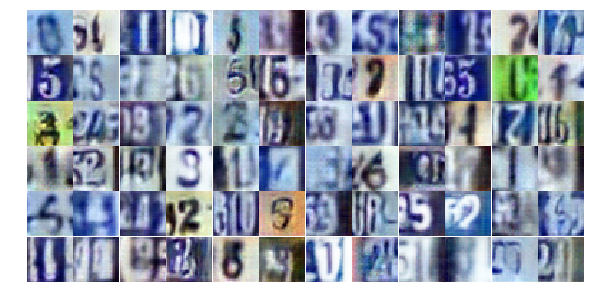

Epoch 18/24... Discriminator Loss: 0.7986... Generator Loss: 0.9516
Epoch 18/24... Discriminator Loss: 0.7581... Generator Loss: 1.0314
Epoch 18/24... Discriminator Loss: 0.8177... Generator Loss: 1.0004
Epoch 18/24... Discriminator Loss: 0.7960... Generator Loss: 1.1396
Epoch 18/24... Discriminator Loss: 1.5671... Generator Loss: 0.4140
Epoch 18/24... Discriminator Loss: 0.8449... Generator Loss: 0.7925
Epoch 18/24... Discriminator Loss: 1.2658... Generator Loss: 0.5471
Epoch 18/24... Discriminator Loss: 1.2143... Generator Loss: 1.6960
Epoch 18/24... Discriminator Loss: 0.7230... Generator Loss: 1.4635
Epoch 18/24... Discriminator Loss: 0.4320... Generator Loss: 1.9596


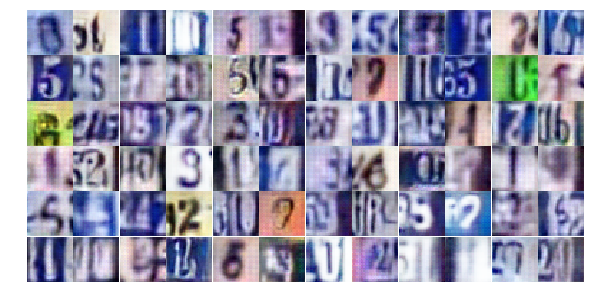

Epoch 18/24... Discriminator Loss: 0.8420... Generator Loss: 0.8653
Epoch 18/24... Discriminator Loss: 1.3807... Generator Loss: 0.4383
Epoch 18/24... Discriminator Loss: 0.9515... Generator Loss: 1.1454
Epoch 18/24... Discriminator Loss: 1.0625... Generator Loss: 0.8334
Epoch 18/24... Discriminator Loss: 0.7774... Generator Loss: 0.9310
Epoch 18/24... Discriminator Loss: 0.7297... Generator Loss: 1.7140
Epoch 18/24... Discriminator Loss: 0.8429... Generator Loss: 0.9524
Epoch 18/24... Discriminator Loss: 0.6009... Generator Loss: 1.5575
Epoch 18/24... Discriminator Loss: 1.0742... Generator Loss: 0.7104
Epoch 18/24... Discriminator Loss: 0.6432... Generator Loss: 1.2130


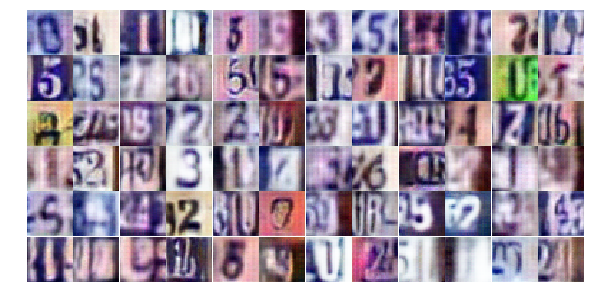

Epoch 18/24... Discriminator Loss: 0.0723... Generator Loss: 5.1927
Epoch 19/24... Discriminator Loss: 2.7499... Generator Loss: 0.1204
Epoch 19/24... Discriminator Loss: 1.5870... Generator Loss: 0.6743
Epoch 19/24... Discriminator Loss: 1.0464... Generator Loss: 0.7334
Epoch 19/24... Discriminator Loss: 0.8389... Generator Loss: 1.1619
Epoch 19/24... Discriminator Loss: 1.6014... Generator Loss: 0.4004
Epoch 19/24... Discriminator Loss: 0.7845... Generator Loss: 1.0176
Epoch 19/24... Discriminator Loss: 1.3654... Generator Loss: 0.4541
Epoch 19/24... Discriminator Loss: 0.8402... Generator Loss: 1.1019
Epoch 19/24... Discriminator Loss: 0.7654... Generator Loss: 1.1015


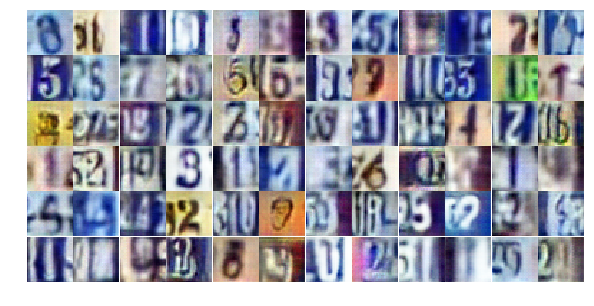

Epoch 19/24... Discriminator Loss: 0.9691... Generator Loss: 0.7309
Epoch 19/24... Discriminator Loss: 0.7016... Generator Loss: 1.3507
Epoch 19/24... Discriminator Loss: 0.7671... Generator Loss: 0.9968
Epoch 19/24... Discriminator Loss: 1.2884... Generator Loss: 0.4532
Epoch 19/24... Discriminator Loss: 1.2356... Generator Loss: 0.5156
Epoch 19/24... Discriminator Loss: 0.7135... Generator Loss: 1.3013
Epoch 19/24... Discriminator Loss: 1.6478... Generator Loss: 0.3734
Epoch 19/24... Discriminator Loss: 0.8259... Generator Loss: 1.2816
Epoch 19/24... Discriminator Loss: 0.9672... Generator Loss: 1.1100
Epoch 19/24... Discriminator Loss: 1.5010... Generator Loss: 0.4320


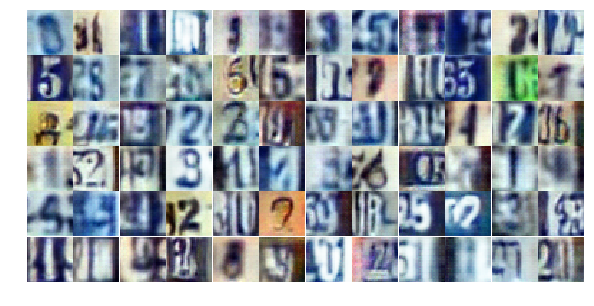

Epoch 19/24... Discriminator Loss: 0.8451... Generator Loss: 0.9815
Epoch 19/24... Discriminator Loss: 1.3428... Generator Loss: 0.5551
Epoch 19/24... Discriminator Loss: 1.3256... Generator Loss: 0.5426
Epoch 19/24... Discriminator Loss: 1.2710... Generator Loss: 0.5731
Epoch 19/24... Discriminator Loss: 1.0602... Generator Loss: 0.7142
Epoch 19/24... Discriminator Loss: 0.5415... Generator Loss: 1.8265
Epoch 19/24... Discriminator Loss: 1.1492... Generator Loss: 0.6529
Epoch 19/24... Discriminator Loss: 0.9913... Generator Loss: 0.9846
Epoch 19/24... Discriminator Loss: 0.7260... Generator Loss: 1.2761
Epoch 19/24... Discriminator Loss: 0.9054... Generator Loss: 0.8893


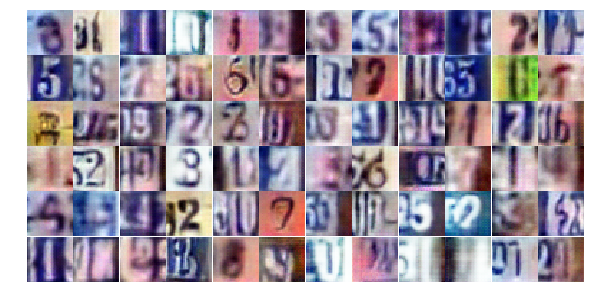

Epoch 19/24... Discriminator Loss: 1.0047... Generator Loss: 0.7521
Epoch 19/24... Discriminator Loss: 0.8838... Generator Loss: 0.8010
Epoch 19/24... Discriminator Loss: 0.8817... Generator Loss: 0.7742
Epoch 19/24... Discriminator Loss: 0.7040... Generator Loss: 1.0866
Epoch 19/24... Discriminator Loss: 0.5939... Generator Loss: 1.1537
Epoch 19/24... Discriminator Loss: 1.9716... Generator Loss: 1.9857
Epoch 19/24... Discriminator Loss: 1.0500... Generator Loss: 0.8835
Epoch 19/24... Discriminator Loss: 0.8166... Generator Loss: 0.9831
Epoch 19/24... Discriminator Loss: 1.3128... Generator Loss: 0.5738
Epoch 19/24... Discriminator Loss: 1.0146... Generator Loss: 0.6732


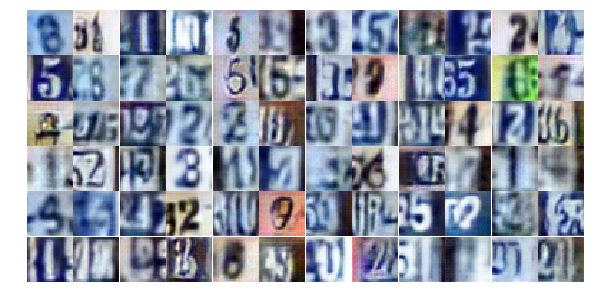

Epoch 19/24... Discriminator Loss: 0.6264... Generator Loss: 1.1625
Epoch 19/24... Discriminator Loss: 1.4771... Generator Loss: 0.4485
Epoch 19/24... Discriminator Loss: 1.4905... Generator Loss: 0.3708
Epoch 19/24... Discriminator Loss: 0.3595... Generator Loss: 1.9911
Epoch 19/24... Discriminator Loss: 0.2488... Generator Loss: 2.0288
Epoch 19/24... Discriminator Loss: 0.7246... Generator Loss: 1.6768
Epoch 19/24... Discriminator Loss: 0.7099... Generator Loss: 1.7480
Epoch 19/24... Discriminator Loss: 0.1195... Generator Loss: 3.3447
Epoch 19/24... Discriminator Loss: 0.1332... Generator Loss: 2.6535
Epoch 19/24... Discriminator Loss: 0.0810... Generator Loss: 4.0645


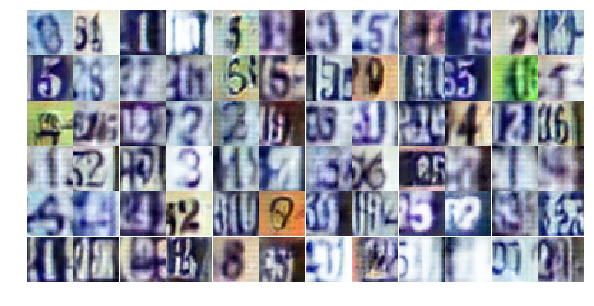

Epoch 19/24... Discriminator Loss: 0.0905... Generator Loss: 3.0182
Epoch 19/24... Discriminator Loss: 1.9336... Generator Loss: 0.2783
Epoch 19/24... Discriminator Loss: 0.6239... Generator Loss: 1.9866
Epoch 19/24... Discriminator Loss: 0.8106... Generator Loss: 1.2749
Epoch 19/24... Discriminator Loss: 1.0382... Generator Loss: 0.7362
Epoch 19/24... Discriminator Loss: 0.8918... Generator Loss: 0.9360
Epoch 19/24... Discriminator Loss: 1.1471... Generator Loss: 0.6672
Epoch 19/24... Discriminator Loss: 0.6928... Generator Loss: 1.1465
Epoch 20/24... Discriminator Loss: 0.8405... Generator Loss: 1.0067
Epoch 20/24... Discriminator Loss: 1.0460... Generator Loss: 0.6701


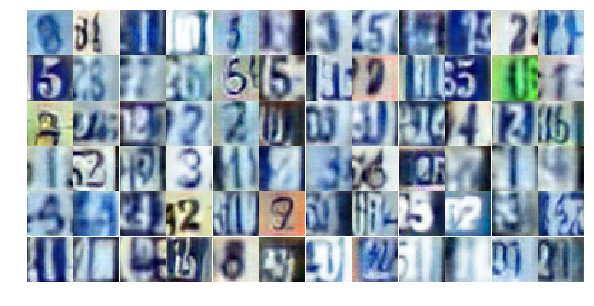

Epoch 20/24... Discriminator Loss: 1.0431... Generator Loss: 0.6398
Epoch 20/24... Discriminator Loss: 0.9857... Generator Loss: 0.8493
Epoch 20/24... Discriminator Loss: 1.3952... Generator Loss: 0.4588
Epoch 20/24... Discriminator Loss: 1.2366... Generator Loss: 0.6035
Epoch 20/24... Discriminator Loss: 0.5516... Generator Loss: 1.3524
Epoch 20/24... Discriminator Loss: 0.8191... Generator Loss: 0.9643
Epoch 20/24... Discriminator Loss: 0.9180... Generator Loss: 0.8139
Epoch 20/24... Discriminator Loss: 0.9482... Generator Loss: 1.8727
Epoch 20/24... Discriminator Loss: 0.9895... Generator Loss: 0.9885
Epoch 20/24... Discriminator Loss: 1.3161... Generator Loss: 0.5630


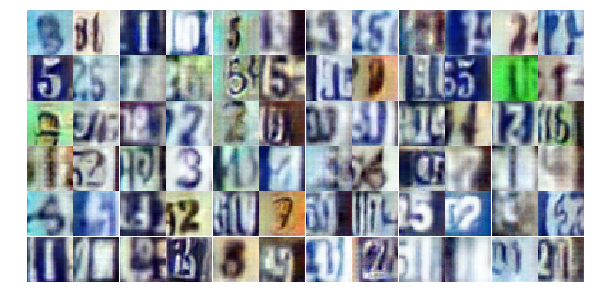

Epoch 20/24... Discriminator Loss: 1.6138... Generator Loss: 0.3716
Epoch 20/24... Discriminator Loss: 1.2174... Generator Loss: 0.5176
Epoch 20/24... Discriminator Loss: 0.8809... Generator Loss: 1.1919
Epoch 20/24... Discriminator Loss: 0.6092... Generator Loss: 1.2573
Epoch 20/24... Discriminator Loss: 1.0381... Generator Loss: 0.6543
Epoch 20/24... Discriminator Loss: 0.9224... Generator Loss: 1.1758
Epoch 20/24... Discriminator Loss: 1.4989... Generator Loss: 0.4106
Epoch 20/24... Discriminator Loss: 1.1424... Generator Loss: 0.6028
Epoch 20/24... Discriminator Loss: 0.4792... Generator Loss: 1.4404
Epoch 20/24... Discriminator Loss: 1.2696... Generator Loss: 0.5452


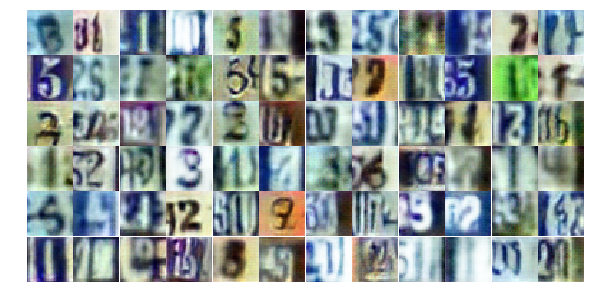

Epoch 20/24... Discriminator Loss: 0.2681... Generator Loss: 2.2900
Epoch 20/24... Discriminator Loss: 1.0058... Generator Loss: 1.4433
Epoch 20/24... Discriminator Loss: 0.6738... Generator Loss: 1.1580
Epoch 20/24... Discriminator Loss: 1.8234... Generator Loss: 0.3262
Epoch 20/24... Discriminator Loss: 1.2489... Generator Loss: 0.5373
Epoch 20/24... Discriminator Loss: 0.6407... Generator Loss: 1.2298
Epoch 20/24... Discriminator Loss: 0.9794... Generator Loss: 1.8050
Epoch 20/24... Discriminator Loss: 1.7218... Generator Loss: 0.3215
Epoch 20/24... Discriminator Loss: 0.8726... Generator Loss: 0.9346
Epoch 20/24... Discriminator Loss: 0.6043... Generator Loss: 1.1200


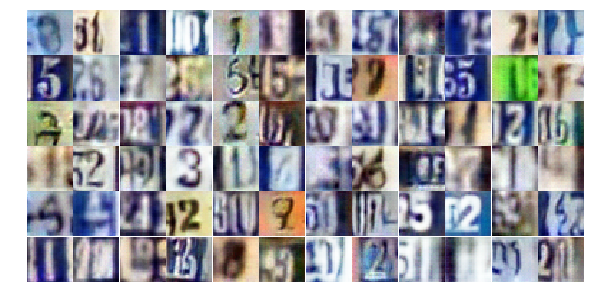

Epoch 20/24... Discriminator Loss: 0.8321... Generator Loss: 0.9633
Epoch 20/24... Discriminator Loss: 1.1657... Generator Loss: 0.5562
Epoch 20/24... Discriminator Loss: 1.2791... Generator Loss: 3.5732
Epoch 20/24... Discriminator Loss: 1.5879... Generator Loss: 1.3040
Epoch 20/24... Discriminator Loss: 1.6352... Generator Loss: 0.4544
Epoch 20/24... Discriminator Loss: 1.0179... Generator Loss: 0.9752
Epoch 20/24... Discriminator Loss: 0.9946... Generator Loss: 0.9819
Epoch 20/24... Discriminator Loss: 0.9212... Generator Loss: 0.9845
Epoch 20/24... Discriminator Loss: 0.9433... Generator Loss: 0.8647
Epoch 20/24... Discriminator Loss: 1.2967... Generator Loss: 0.6760


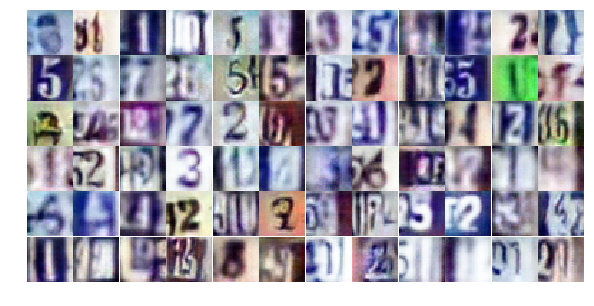

Epoch 20/24... Discriminator Loss: 1.0754... Generator Loss: 0.6793
Epoch 20/24... Discriminator Loss: 1.1033... Generator Loss: 0.6150
Epoch 20/24... Discriminator Loss: 0.6701... Generator Loss: 1.2928
Epoch 20/24... Discriminator Loss: 1.0130... Generator Loss: 0.7052
Epoch 20/24... Discriminator Loss: 0.9217... Generator Loss: 1.0107
Epoch 20/24... Discriminator Loss: 1.1211... Generator Loss: 0.7339
Epoch 20/24... Discriminator Loss: 1.7633... Generator Loss: 0.3255
Epoch 20/24... Discriminator Loss: 0.7699... Generator Loss: 2.2748
Epoch 20/24... Discriminator Loss: 1.3793... Generator Loss: 0.4351
Epoch 20/24... Discriminator Loss: 0.8625... Generator Loss: 0.8659


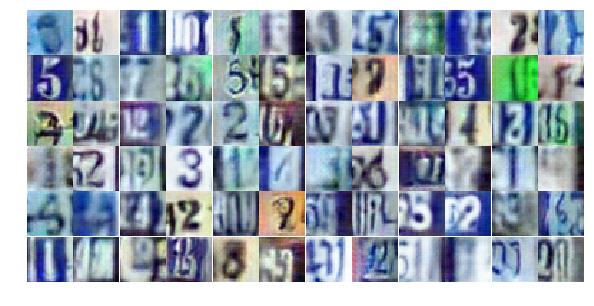

Epoch 20/24... Discriminator Loss: 0.4516... Generator Loss: 1.4845
Epoch 20/24... Discriminator Loss: 1.4113... Generator Loss: 0.4693
Epoch 20/24... Discriminator Loss: 0.0849... Generator Loss: 3.7328
Epoch 20/24... Discriminator Loss: 1.4181... Generator Loss: 1.9122
Epoch 20/24... Discriminator Loss: 0.6407... Generator Loss: 1.4097
Epoch 20/24... Discriminator Loss: 1.0111... Generator Loss: 0.7035
Epoch 21/24... Discriminator Loss: 1.0408... Generator Loss: 0.8645
Epoch 21/24... Discriminator Loss: 1.2073... Generator Loss: 0.6004
Epoch 21/24... Discriminator Loss: 1.1434... Generator Loss: 0.7026
Epoch 21/24... Discriminator Loss: 1.0119... Generator Loss: 0.7308


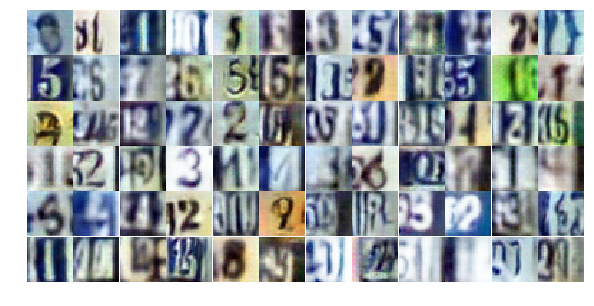

Epoch 21/24... Discriminator Loss: 0.6567... Generator Loss: 1.2254
Epoch 21/24... Discriminator Loss: 2.0802... Generator Loss: 0.2538
Epoch 21/24... Discriminator Loss: 0.7579... Generator Loss: 1.0187
Epoch 21/24... Discriminator Loss: 0.6454... Generator Loss: 1.3400
Epoch 21/24... Discriminator Loss: 1.1100... Generator Loss: 0.7291
Epoch 21/24... Discriminator Loss: 0.6132... Generator Loss: 1.1853
Epoch 21/24... Discriminator Loss: 0.9932... Generator Loss: 0.6862
Epoch 21/24... Discriminator Loss: 0.1915... Generator Loss: 2.5050
Epoch 21/24... Discriminator Loss: 0.7725... Generator Loss: 1.1477
Epoch 21/24... Discriminator Loss: 0.9824... Generator Loss: 0.7528


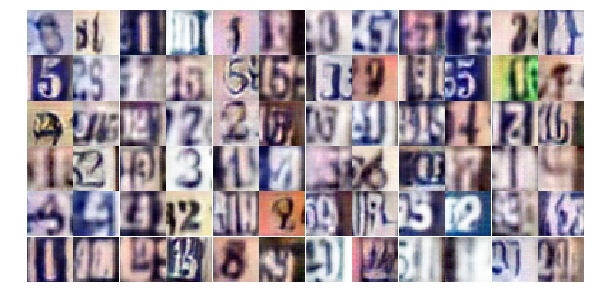

Epoch 21/24... Discriminator Loss: 0.1099... Generator Loss: 4.5391
Epoch 21/24... Discriminator Loss: 0.3619... Generator Loss: 2.2862
Epoch 21/24... Discriminator Loss: 0.3161... Generator Loss: 1.8371
Epoch 21/24... Discriminator Loss: 1.6910... Generator Loss: 2.8249
Epoch 21/24... Discriminator Loss: 1.1963... Generator Loss: 0.6207
Epoch 21/24... Discriminator Loss: 1.6410... Generator Loss: 0.2853
Epoch 21/24... Discriminator Loss: 1.2787... Generator Loss: 0.6334
Epoch 21/24... Discriminator Loss: 0.4722... Generator Loss: 2.2867
Epoch 21/24... Discriminator Loss: 0.6608... Generator Loss: 1.2001
Epoch 21/24... Discriminator Loss: 0.7425... Generator Loss: 1.0695


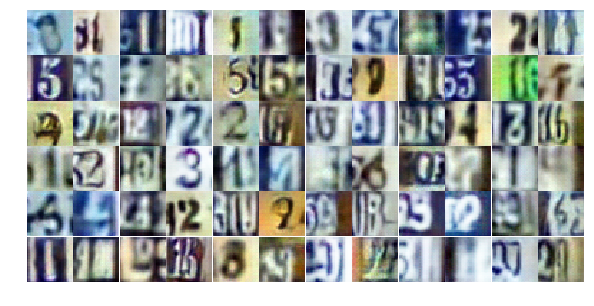

Epoch 21/24... Discriminator Loss: 1.2569... Generator Loss: 0.5705
Epoch 21/24... Discriminator Loss: 0.6598... Generator Loss: 1.1802
Epoch 21/24... Discriminator Loss: 1.3384... Generator Loss: 0.5067
Epoch 21/24... Discriminator Loss: 1.0216... Generator Loss: 0.8372
Epoch 21/24... Discriminator Loss: 1.2740... Generator Loss: 0.5302
Epoch 21/24... Discriminator Loss: 1.0396... Generator Loss: 0.7622
Epoch 21/24... Discriminator Loss: 0.7105... Generator Loss: 1.0718
Epoch 21/24... Discriminator Loss: 0.9322... Generator Loss: 0.8169
Epoch 21/24... Discriminator Loss: 0.2682... Generator Loss: 2.5700
Epoch 21/24... Discriminator Loss: 0.6075... Generator Loss: 1.1392


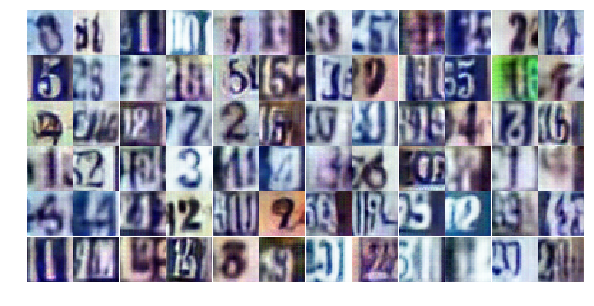

Epoch 21/24... Discriminator Loss: 0.0653... Generator Loss: 3.8931
Epoch 21/24... Discriminator Loss: 1.4213... Generator Loss: 1.4352
Epoch 21/24... Discriminator Loss: 1.0532... Generator Loss: 1.0931
Epoch 21/24... Discriminator Loss: 0.5121... Generator Loss: 1.4569
Epoch 21/24... Discriminator Loss: 0.7745... Generator Loss: 1.0720
Epoch 21/24... Discriminator Loss: 0.7602... Generator Loss: 1.0418
Epoch 21/24... Discriminator Loss: 1.1253... Generator Loss: 0.6362
Epoch 21/24... Discriminator Loss: 1.5842... Generator Loss: 0.3559
Epoch 21/24... Discriminator Loss: 0.2079... Generator Loss: 2.9741
Epoch 21/24... Discriminator Loss: 0.2290... Generator Loss: 2.6764


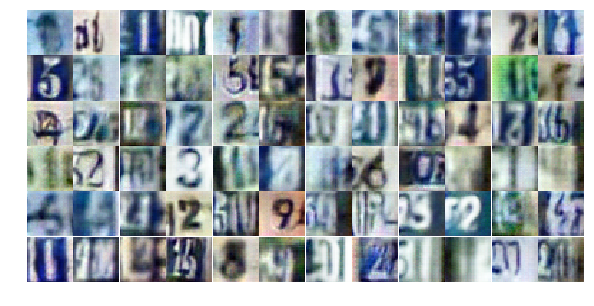

Epoch 21/24... Discriminator Loss: 0.7114... Generator Loss: 1.0333
Epoch 21/24... Discriminator Loss: 1.5317... Generator Loss: 0.3821
Epoch 21/24... Discriminator Loss: 1.2532... Generator Loss: 0.7190
Epoch 21/24... Discriminator Loss: 1.7931... Generator Loss: 0.3518
Epoch 21/24... Discriminator Loss: 0.6949... Generator Loss: 1.5173
Epoch 21/24... Discriminator Loss: 1.1358... Generator Loss: 1.9566
Epoch 21/24... Discriminator Loss: 1.1078... Generator Loss: 0.6680
Epoch 21/24... Discriminator Loss: 1.0553... Generator Loss: 0.7882
Epoch 21/24... Discriminator Loss: 1.3077... Generator Loss: 0.5419
Epoch 21/24... Discriminator Loss: 0.6735... Generator Loss: 1.1375


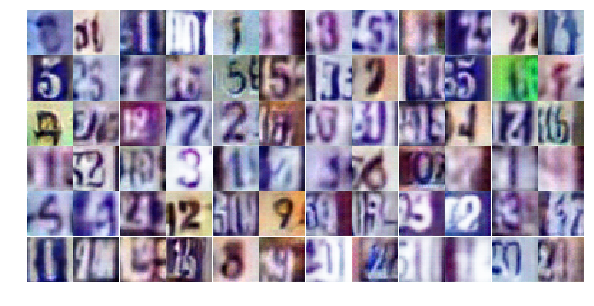

Epoch 21/24... Discriminator Loss: 0.8386... Generator Loss: 0.9283
Epoch 21/24... Discriminator Loss: 1.3706... Generator Loss: 0.4714
Epoch 21/24... Discriminator Loss: 0.0666... Generator Loss: 5.6428
Epoch 22/24... Discriminator Loss: 0.6737... Generator Loss: 0.9876
Epoch 22/24... Discriminator Loss: 0.1456... Generator Loss: 3.2155
Epoch 22/24... Discriminator Loss: 0.1049... Generator Loss: 3.1110
Epoch 22/24... Discriminator Loss: 0.0324... Generator Loss: 4.5074
Epoch 22/24... Discriminator Loss: 0.1048... Generator Loss: 2.9557
Epoch 22/24... Discriminator Loss: 3.9961... Generator Loss: 5.4208
Epoch 22/24... Discriminator Loss: 1.0371... Generator Loss: 0.7582


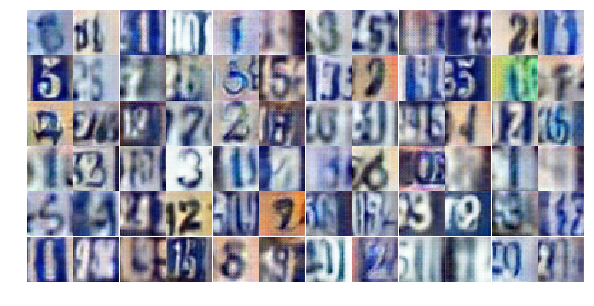

Epoch 22/24... Discriminator Loss: 1.2533... Generator Loss: 0.6164
Epoch 22/24... Discriminator Loss: 0.9693... Generator Loss: 1.9755
Epoch 22/24... Discriminator Loss: 1.7953... Generator Loss: 0.3865
Epoch 22/24... Discriminator Loss: 1.0221... Generator Loss: 0.8617
Epoch 22/24... Discriminator Loss: 1.0993... Generator Loss: 0.8982
Epoch 22/24... Discriminator Loss: 0.8507... Generator Loss: 1.4847
Epoch 22/24... Discriminator Loss: 1.3905... Generator Loss: 0.4868
Epoch 22/24... Discriminator Loss: 0.6718... Generator Loss: 1.4696
Epoch 22/24... Discriminator Loss: 0.9390... Generator Loss: 1.0907
Epoch 22/24... Discriminator Loss: 1.8497... Generator Loss: 0.6849


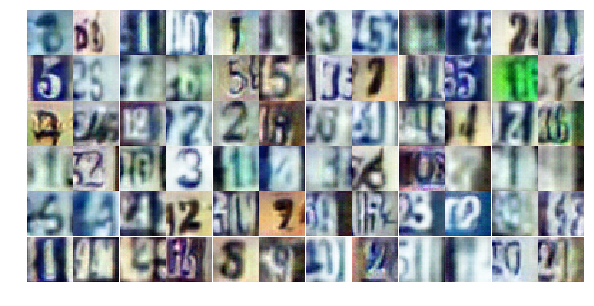

Epoch 22/24... Discriminator Loss: 0.1994... Generator Loss: 2.5238
Epoch 22/24... Discriminator Loss: 0.6801... Generator Loss: 1.3869
Epoch 22/24... Discriminator Loss: 1.4497... Generator Loss: 0.4595
Epoch 22/24... Discriminator Loss: 0.5253... Generator Loss: 1.3393
Epoch 22/24... Discriminator Loss: 0.8555... Generator Loss: 0.8859
Epoch 22/24... Discriminator Loss: 0.9936... Generator Loss: 1.4353
Epoch 22/24... Discriminator Loss: 0.7679... Generator Loss: 1.1382
Epoch 22/24... Discriminator Loss: 0.4382... Generator Loss: 1.7385
Epoch 22/24... Discriminator Loss: 0.7212... Generator Loss: 1.2941
Epoch 22/24... Discriminator Loss: 1.0352... Generator Loss: 0.7599


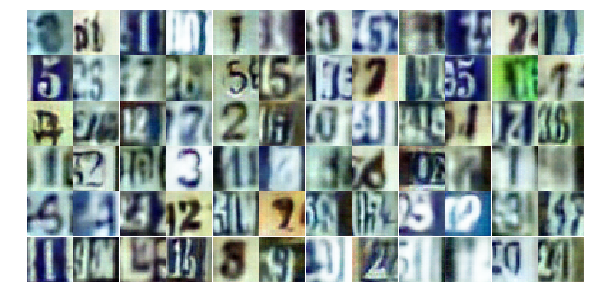

Epoch 22/24... Discriminator Loss: 0.6476... Generator Loss: 1.2276
Epoch 22/24... Discriminator Loss: 0.9403... Generator Loss: 0.7954
Epoch 22/24... Discriminator Loss: 0.9205... Generator Loss: 0.9109
Epoch 22/24... Discriminator Loss: 0.9282... Generator Loss: 0.8382
Epoch 22/24... Discriminator Loss: 0.7734... Generator Loss: 0.9734
Epoch 22/24... Discriminator Loss: 1.3246... Generator Loss: 0.4986
Epoch 22/24... Discriminator Loss: 1.5997... Generator Loss: 0.3430
Epoch 22/24... Discriminator Loss: 0.4872... Generator Loss: 1.7761
Epoch 22/24... Discriminator Loss: 1.4365... Generator Loss: 0.5083
Epoch 22/24... Discriminator Loss: 1.3703... Generator Loss: 0.4076


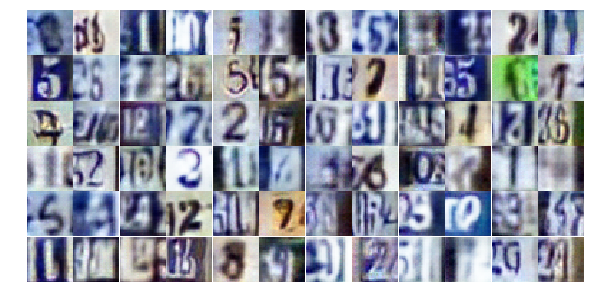

Epoch 22/24... Discriminator Loss: 0.9152... Generator Loss: 0.9370
Epoch 22/24... Discriminator Loss: 0.6671... Generator Loss: 1.1840
Epoch 22/24... Discriminator Loss: 0.7026... Generator Loss: 1.0290
Epoch 22/24... Discriminator Loss: 0.7740... Generator Loss: 0.9780
Epoch 22/24... Discriminator Loss: 0.6568... Generator Loss: 1.0450
Epoch 22/24... Discriminator Loss: 0.3757... Generator Loss: 1.7540
Epoch 22/24... Discriminator Loss: 0.9498... Generator Loss: 0.7349
Epoch 22/24... Discriminator Loss: 1.0267... Generator Loss: 0.7972
Epoch 22/24... Discriminator Loss: 1.3920... Generator Loss: 0.5315
Epoch 22/24... Discriminator Loss: 0.0969... Generator Loss: 3.2754


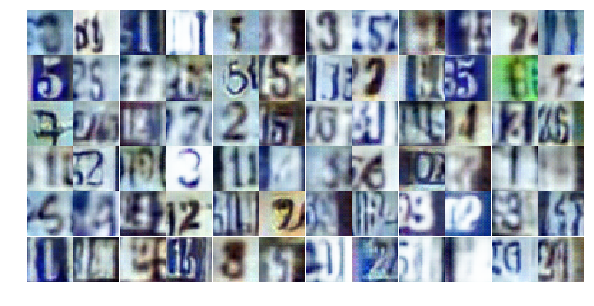

Epoch 22/24... Discriminator Loss: 0.2968... Generator Loss: 2.6112
Epoch 22/24... Discriminator Loss: 0.1321... Generator Loss: 3.0904
Epoch 22/24... Discriminator Loss: 0.9032... Generator Loss: 2.3347
Epoch 22/24... Discriminator Loss: 1.3862... Generator Loss: 0.6217
Epoch 22/24... Discriminator Loss: 1.1646... Generator Loss: 0.6121
Epoch 22/24... Discriminator Loss: 1.1136... Generator Loss: 0.7805
Epoch 22/24... Discriminator Loss: 0.9485... Generator Loss: 0.9509
Epoch 22/24... Discriminator Loss: 0.8697... Generator Loss: 0.8922
Epoch 22/24... Discriminator Loss: 1.9132... Generator Loss: 0.2949
Epoch 22/24... Discriminator Loss: 1.0394... Generator Loss: 0.8155


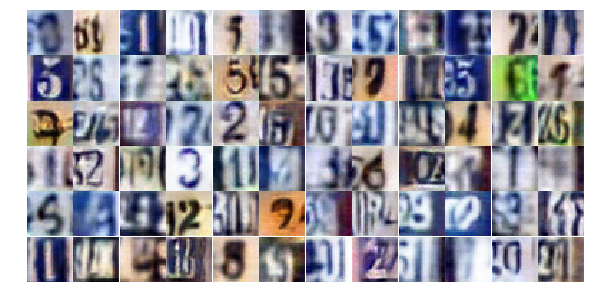

Epoch 23/24... Discriminator Loss: 0.8260... Generator Loss: 1.0784
Epoch 23/24... Discriminator Loss: 0.5233... Generator Loss: 1.4437
Epoch 23/24... Discriminator Loss: 0.8115... Generator Loss: 0.9687
Epoch 23/24... Discriminator Loss: 0.8446... Generator Loss: 0.8283
Epoch 23/24... Discriminator Loss: 0.8757... Generator Loss: 0.9007
Epoch 23/24... Discriminator Loss: 1.3642... Generator Loss: 0.5279
Epoch 23/24... Discriminator Loss: 1.0225... Generator Loss: 0.7086
Epoch 23/24... Discriminator Loss: 0.7905... Generator Loss: 0.9371
Epoch 23/24... Discriminator Loss: 1.4175... Generator Loss: 0.5143
Epoch 23/24... Discriminator Loss: 0.9260... Generator Loss: 2.4497


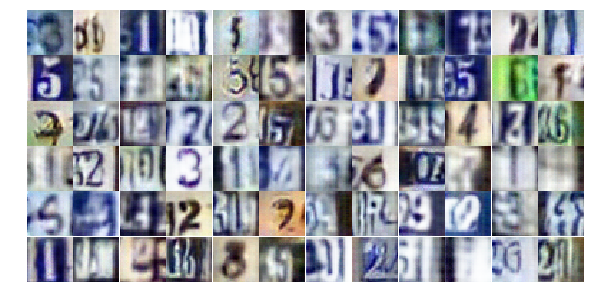

Epoch 23/24... Discriminator Loss: 0.6624... Generator Loss: 1.2499
Epoch 23/24... Discriminator Loss: 0.3684... Generator Loss: 2.9754
Epoch 23/24... Discriminator Loss: 1.1524... Generator Loss: 3.5788
Epoch 23/24... Discriminator Loss: 0.6172... Generator Loss: 1.3306
Epoch 23/24... Discriminator Loss: 0.2126... Generator Loss: 2.8496
Epoch 23/24... Discriminator Loss: 0.5106... Generator Loss: 1.2845
Epoch 23/24... Discriminator Loss: 0.1705... Generator Loss: 2.6006
Epoch 23/24... Discriminator Loss: 0.8176... Generator Loss: 0.9366
Epoch 23/24... Discriminator Loss: 1.0003... Generator Loss: 0.9387
Epoch 23/24... Discriminator Loss: 1.1883... Generator Loss: 0.6764


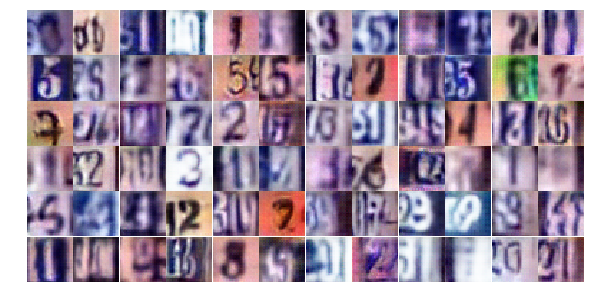

Epoch 23/24... Discriminator Loss: 1.3192... Generator Loss: 0.4948
Epoch 23/24... Discriminator Loss: 0.7809... Generator Loss: 1.1707
Epoch 23/24... Discriminator Loss: 0.9064... Generator Loss: 0.9134
Epoch 23/24... Discriminator Loss: 0.8197... Generator Loss: 1.0135
Epoch 23/24... Discriminator Loss: 0.7753... Generator Loss: 1.3096
Epoch 23/24... Discriminator Loss: 0.8466... Generator Loss: 1.0391
Epoch 23/24... Discriminator Loss: 1.0231... Generator Loss: 0.7157
Epoch 23/24... Discriminator Loss: 0.8384... Generator Loss: 1.1128
Epoch 23/24... Discriminator Loss: 0.7290... Generator Loss: 1.2145
Epoch 23/24... Discriminator Loss: 1.2284... Generator Loss: 0.6117


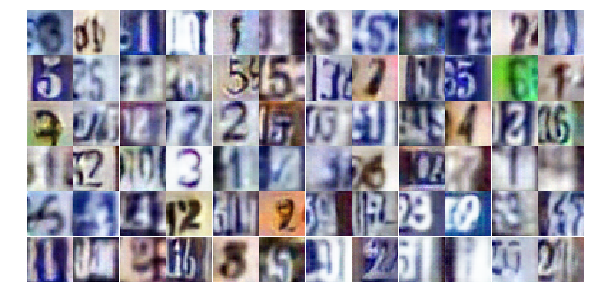

Epoch 23/24... Discriminator Loss: 0.6358... Generator Loss: 1.3880
Epoch 23/24... Discriminator Loss: 0.8183... Generator Loss: 0.9111
Epoch 23/24... Discriminator Loss: 1.0313... Generator Loss: 0.7501
Epoch 23/24... Discriminator Loss: 1.4416... Generator Loss: 0.4647
Epoch 23/24... Discriminator Loss: 1.0075... Generator Loss: 1.7902
Epoch 23/24... Discriminator Loss: 1.3039... Generator Loss: 0.4773
Epoch 23/24... Discriminator Loss: 0.8828... Generator Loss: 1.7805
Epoch 23/24... Discriminator Loss: 0.6202... Generator Loss: 2.3025
Epoch 23/24... Discriminator Loss: 0.1769... Generator Loss: 4.4658
Epoch 23/24... Discriminator Loss: 0.4197... Generator Loss: 1.6726


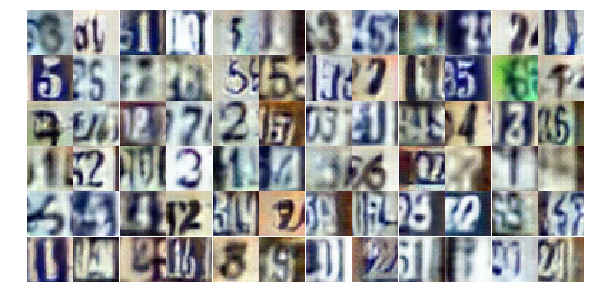

Epoch 23/24... Discriminator Loss: 0.2685... Generator Loss: 2.5254
Epoch 23/24... Discriminator Loss: 0.5861... Generator Loss: 1.4360
Epoch 23/24... Discriminator Loss: 1.8841... Generator Loss: 0.3083
Epoch 23/24... Discriminator Loss: 0.9910... Generator Loss: 0.8006
Epoch 23/24... Discriminator Loss: 0.8004... Generator Loss: 2.5057
Epoch 23/24... Discriminator Loss: 1.2970... Generator Loss: 2.6995
Epoch 23/24... Discriminator Loss: 0.8433... Generator Loss: 1.0299
Epoch 23/24... Discriminator Loss: 1.2814... Generator Loss: 0.7862
Epoch 23/24... Discriminator Loss: 0.8455... Generator Loss: 1.1027
Epoch 23/24... Discriminator Loss: 1.0952... Generator Loss: 0.7436


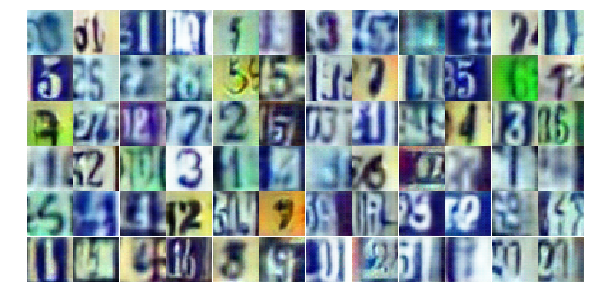

Epoch 23/24... Discriminator Loss: 0.7979... Generator Loss: 1.3754
Epoch 23/24... Discriminator Loss: 2.0274... Generator Loss: 0.2199
Epoch 23/24... Discriminator Loss: 1.0089... Generator Loss: 0.7798
Epoch 23/24... Discriminator Loss: 0.5159... Generator Loss: 1.5713
Epoch 23/24... Discriminator Loss: 1.2392... Generator Loss: 0.6023
Epoch 23/24... Discriminator Loss: 0.9531... Generator Loss: 0.9948
Epoch 23/24... Discriminator Loss: 0.9790... Generator Loss: 0.9074
Epoch 24/24... Discriminator Loss: 1.0982... Generator Loss: 0.6105
Epoch 24/24... Discriminator Loss: 1.0625... Generator Loss: 0.7409
Epoch 24/24... Discriminator Loss: 1.3462... Generator Loss: 0.5048


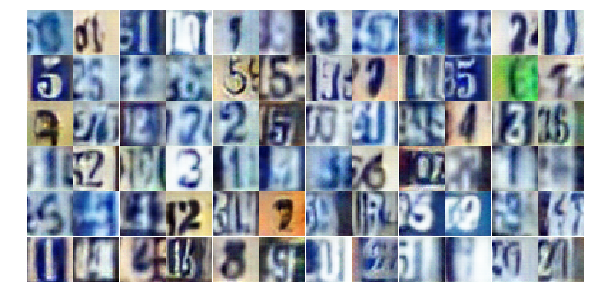

Epoch 24/24... Discriminator Loss: 0.9268... Generator Loss: 1.6276
Epoch 24/24... Discriminator Loss: 0.9277... Generator Loss: 1.0091
Epoch 24/24... Discriminator Loss: 0.7264... Generator Loss: 1.1323
Epoch 24/24... Discriminator Loss: 0.8932... Generator Loss: 1.1639
Epoch 24/24... Discriminator Loss: 1.5546... Generator Loss: 0.4095
Epoch 24/24... Discriminator Loss: 0.9099... Generator Loss: 0.8225
Epoch 24/24... Discriminator Loss: 0.8568... Generator Loss: 0.8734
Epoch 24/24... Discriminator Loss: 1.3513... Generator Loss: 0.4801
Epoch 24/24... Discriminator Loss: 0.5352... Generator Loss: 1.4157
Epoch 24/24... Discriminator Loss: 0.7259... Generator Loss: 1.2016


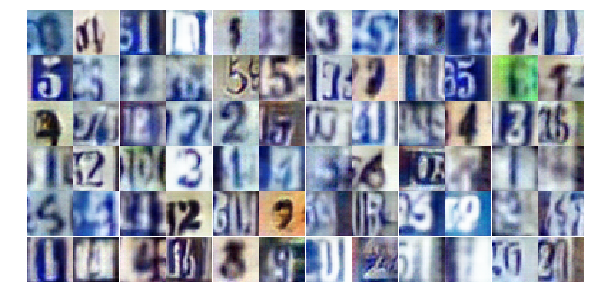

Epoch 24/24... Discriminator Loss: 1.5951... Generator Loss: 0.3748
Epoch 24/24... Discriminator Loss: 1.0584... Generator Loss: 0.7151
Epoch 24/24... Discriminator Loss: 1.0025... Generator Loss: 0.7265
Epoch 24/24... Discriminator Loss: 0.8166... Generator Loss: 0.8084
Epoch 24/24... Discriminator Loss: 1.7093... Generator Loss: 1.8949
Epoch 24/24... Discriminator Loss: 1.0791... Generator Loss: 0.7451
Epoch 24/24... Discriminator Loss: 0.6398... Generator Loss: 1.4442
Epoch 24/24... Discriminator Loss: 1.4447... Generator Loss: 0.4330
Epoch 24/24... Discriminator Loss: 0.9804... Generator Loss: 0.9380
Epoch 24/24... Discriminator Loss: 0.5564... Generator Loss: 1.6440


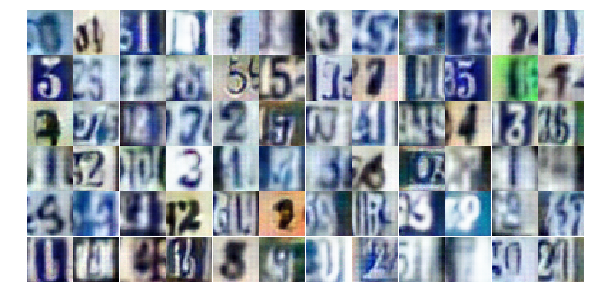

Epoch 24/24... Discriminator Loss: 0.9151... Generator Loss: 0.7993
Epoch 24/24... Discriminator Loss: 1.1040... Generator Loss: 0.6684
Epoch 24/24... Discriminator Loss: 0.6134... Generator Loss: 1.3063
Epoch 24/24... Discriminator Loss: 1.8057... Generator Loss: 0.3239
Epoch 24/24... Discriminator Loss: 0.7626... Generator Loss: 1.2481
Epoch 24/24... Discriminator Loss: 0.6624... Generator Loss: 1.1523
Epoch 24/24... Discriminator Loss: 0.6661... Generator Loss: 1.5910
Epoch 24/24... Discriminator Loss: 0.9824... Generator Loss: 2.0254
Epoch 24/24... Discriminator Loss: 0.8263... Generator Loss: 1.0096
Epoch 24/24... Discriminator Loss: 0.7497... Generator Loss: 1.5855


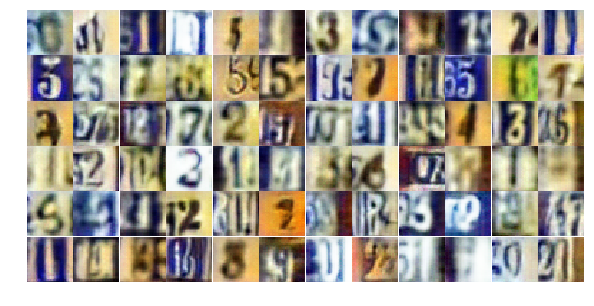

Epoch 24/24... Discriminator Loss: 0.7943... Generator Loss: 0.8609
Epoch 24/24... Discriminator Loss: 0.3758... Generator Loss: 2.0202
Epoch 24/24... Discriminator Loss: 0.8441... Generator Loss: 1.1050
Epoch 24/24... Discriminator Loss: 1.4062... Generator Loss: 0.4464
Epoch 24/24... Discriminator Loss: 0.6905... Generator Loss: 1.3085
Epoch 24/24... Discriminator Loss: 1.2406... Generator Loss: 0.7354
Epoch 24/24... Discriminator Loss: 1.2944... Generator Loss: 0.5793
Epoch 24/24... Discriminator Loss: 1.1327... Generator Loss: 0.6895
Epoch 24/24... Discriminator Loss: 0.8549... Generator Loss: 0.9138
Epoch 24/24... Discriminator Loss: 0.7017... Generator Loss: 1.3082


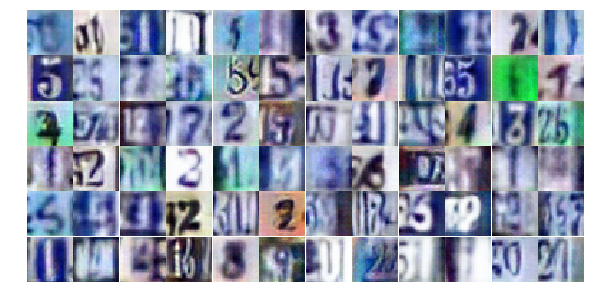

Epoch 24/24... Discriminator Loss: 0.9028... Generator Loss: 0.9685
Epoch 24/24... Discriminator Loss: 1.2962... Generator Loss: 0.5150
Epoch 24/24... Discriminator Loss: 1.1255... Generator Loss: 0.6183
Epoch 24/24... Discriminator Loss: 0.6546... Generator Loss: 1.5336
Epoch 24/24... Discriminator Loss: 1.9275... Generator Loss: 0.3295
Epoch 24/24... Discriminator Loss: 0.5975... Generator Loss: 1.6736
Epoch 24/24... Discriminator Loss: 0.8163... Generator Loss: 0.9657
Epoch 24/24... Discriminator Loss: 0.6000... Generator Loss: 1.4645
Epoch 24/24... Discriminator Loss: 0.9395... Generator Loss: 0.9346
Epoch 24/24... Discriminator Loss: 0.8163... Generator Loss: 1.7508


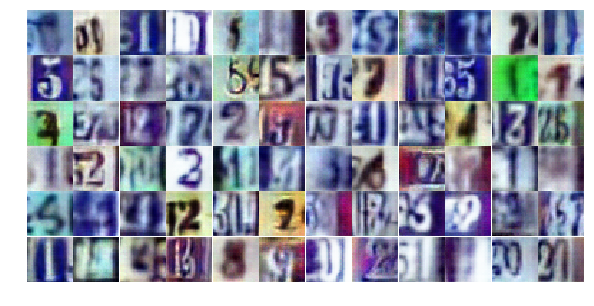

Epoch 24/24... Discriminator Loss: 0.7494... Generator Loss: 0.9665
Epoch 24/24... Discriminator Loss: 2.3434... Generator Loss: 0.1733
Epoch 24/24... Discriminator Loss: 0.5439... Generator Loss: 1.3329
Epoch 24/24... Discriminator Loss: 0.5088... Generator Loss: 2.4796
Epoch 24/24... Discriminator Loss: 1.6325... Generator Loss: 0.4179


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

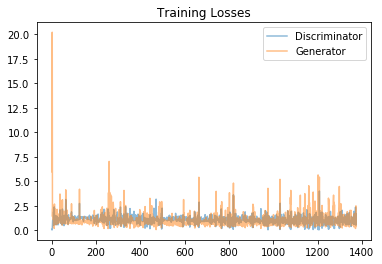

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

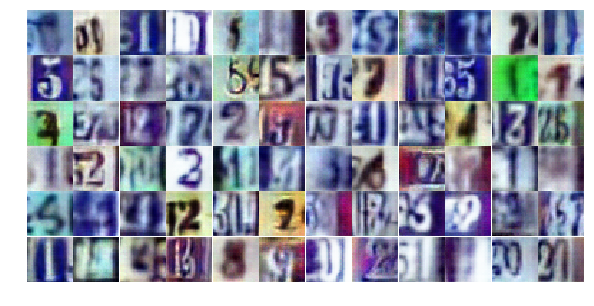

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))